In [1]:
%pip install opencv-python-headless
%pip install torch torchvision
from IPython.display import clear_output
clear_output()

In [2]:
#Imports
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn

In [3]:
# Load the pre-trained model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()  

# Define the transformation
def transform_image(image):
    transform = T.Compose([T.ToTensor()])
    return transform(image).unsqueeze(0)

/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
def highlight_objects(image_path):
    # Load and preprocess the image
    image = Image.open(image_path)
    image_tensor = transform_image(image)

    # Perform object detection
    with torch.no_grad():
        prediction = model(image_tensor)

    # Process the prediction to extract traffic light bounding boxes and scores
    traffic_lights = [(box, score) for box, label, score in zip(prediction[0]['boxes'], prediction[0]['labels'], prediction[0]['scores']) if label == 10]

    print(traffic_lights)
    # Draw bounding boxes and scores on the image
    image_np = np.array(image).copy()
    for box, score in traffic_lights:
        cv2.rectangle(image_np, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)
        font_scale = 1.5  
        text = f"{score:.2f}"
        cv2.putText(image_np, text, (int(box[0]), int(box[1] - 5)), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), 2)


    # Plot the image
    plt.figure(figsize=(8, 8))
    plt.imshow(image_np)
    plt.axis('off')
    plt.show()



[(tensor([249.7021, 174.0422, 286.5320, 245.6430]), tensor(0.9797)), (tensor([682.3071, 326.1063, 697.4260, 353.6336]), tensor(0.9749)), (tensor([471.0038, 304.7966, 486.3607, 341.1022]), tensor(0.9703)), (tensor([183.3099, 265.3594, 198.6426, 307.2576]), tensor(0.9681)), (tensor([955.1448, 310.2568, 976.3661, 345.0390]), tensor(0.9611)), (tensor([151.1092, 326.8573, 170.2305, 370.0235]), tensor(0.9539)), (tensor([8.1747e+02, 2.4838e-01, 8.9230e+02, 5.1647e+01]), tensor(0.8698)), (tensor([638.5706, 384.8969, 651.1051, 406.3977]), tensor(0.7554)), (tensor([104.1210, 350.5381, 121.5074, 380.6320]), tensor(0.7101)), (tensor([960.7530, 413.0642, 969.7478, 422.3832]), tensor(0.2508)), (tensor([922.4460, 381.5597, 930.0648, 393.5283]), tensor(0.2298)), (tensor([940.6448, 391.8529, 945.7400, 402.0235]), tensor(0.1449)), (tensor([881.2569, 361.9889, 894.8793, 375.5937]), tensor(0.1370)), (tensor([238.6250, 168.3126, 277.7022, 237.6173]), tensor(0.1044)), (tensor([184.6353, 328.7255, 195.6842, 

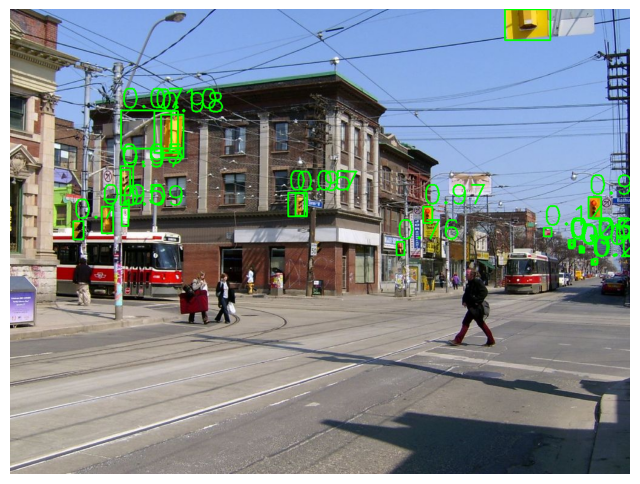

In [5]:
highlight_objects('../data/images/train/03aff25c31c34fd2.jpg')

In [19]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tqdm import tqdm


def classify_traffic_light_color(cropped_image):
    """
    Classifica a cor do semáforo usando processamento de imagem.
    
    Args:
        cropped_image: Imagem recortada do semáforo (numpy array)
        
    Returns:
        str: 'red', 'yellow' ou 'green'
    """
    # Converter para HSV
    hsv = cv2.cvtColor(cropped_image, cv2.COLOR_RGB2HSV)
    
    # Definir intervalos de cor em HSV
    lower_red1 = np.array([0, 100, 100])
    upper_red1 = np.array([10, 255, 255])
    lower_red2 = np.array([160, 100, 100])
    upper_red2 = np.array([180, 255, 255])
    lower_yellow = np.array([15, 100, 100])
    upper_yellow = np.array([35, 255, 255])
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])
    
    # Criar máscaras para cada cor
    mask_red1 = cv2.inRange(hsv, lower_red1, upper_red1)
    mask_red2 = cv2.inRange(hsv, lower_red2, upper_red2)
    mask_red = cv2.bitwise_or(mask_red1, mask_red2)
    mask_yellow = cv2.inRange(hsv, lower_yellow, upper_yellow)
    mask_green = cv2.inRange(hsv, lower_green, upper_green)
    
    # Dividir a imagem em três seções verticais
    height = cropped_image.shape[0]
    top_section = mask_red[0:height//3, :]
    middle_section = mask_yellow[height//3:2*height//3, :]
    bottom_section = mask_green[2*height//3:, :]
    
    # Contar pixels brancos em cada seção
    red_pixels = cv2.countNonZero(top_section)
    yellow_pixels = cv2.countNonZero(middle_section)
    green_pixels = cv2.countNonZero(bottom_section)
    
    # Definir limiar mínimo de pixels
    threshold = 50
    
    # Classificar com base na seção com mais pixels
    if red_pixels > threshold and red_pixels > yellow_pixels and red_pixels > green_pixels:
        return 'red'
    elif yellow_pixels > threshold and yellow_pixels > red_pixels and yellow_pixels > green_pixels:
        return 'yellow'
    elif green_pixels > threshold and green_pixels > red_pixels and green_pixels > yellow_pixels:
        return 'green'
    else:
        return 'unknown'

class TrafficLightPipeline:
    def __init__(self):
        """
        Initialize the traffic light detection and color classification pipeline.
        """
        # Carregar o modelo Faster R-CNN pré-treinado
        self.detection_model = fasterrcnn_resnet50_fpn(pretrained=True)
        self.detection_model.eval()
        
        # Transformação para as imagens
        self.transform = T.Compose([T.ToTensor()])
        
        
    def detect_traffic_lights(self, image):
        """
        Detect traffic lights in an image using your existing detection logic.
        
        Args:
            image: Input image (numpy array)
            
        Returns:
            List of detected traffic lights as [x, y, w, h] bounding boxes
        """
        # Converter numpy array para PIL Image se necessário
        if isinstance(image, np.ndarray):
            image = Image.fromarray(image)
            
        # Preparar imagem
        image_tensor = self.transform(image).unsqueeze(0)
        
        # Realizar detecção
        with torch.no_grad():
            prediction = self.detection_model(image_tensor)
            
        # Extrair apenas as detecções de semáforos (classe 10)
        boxes = []
        scores = []
        for box, label, score in zip(prediction[0]['boxes'], 
                                   prediction[0]['labels'], 
                                   prediction[0]['scores']):
            if label == 10 and score > 0.5:  # Classe 10 = semáforo, threshold = 0.5
                # Converter formato [x1, y1, x2, y2] para [x, y, w, h]
                x1, y1, x2, y2 = box.tolist()
                w = x2 - x1
                h = y2 - y1
                boxes.append([int(x1), int(y1), int(w), int(h)])
                scores.append(score.item())
                
        return boxes, scores
    
    def crop_traffic_lights(self, image, detections):
        """
        Crop traffic lights from the image based on detection bounding boxes.
        
        Args:
            image: Input image (numpy array)
            detections: List of bounding boxes [x, y, w, h]
            
        Returns:
            List of cropped traffic light images
        """
        cropped_images = []
        
        for box in detections:
            x, y, w, h = box
            # Adicionar margem em torno do semáforo
            margin = 5
            x_min = max(0, x - margin)
            y_min = max(0, y - margin)
            x_max = min(image.shape[1], x + w + margin)
            y_max = min(image.shape[0], y + h + margin)
            
            # Recortar o semáforo
            crop = image[y_min:y_max, x_min:x_max]
            
            # Redimensionar para tamanho padrão
            crop = cv2.resize(crop, (64, 128))
            cropped_images.append(crop)
            
        return cropped_images
    
    def build_color_classifier(self):
        """
        Build a CNN model for traffic light color classification.
        
        Returns:
            Compiled Keras model
        """
        model = models.Sequential([
            # Input layer
            layers.Conv2D(32, (3, 3), activation='relu', input_shape=(128, 64, 3)),
            layers.MaxPooling2D((2, 2)),
            
            # Hidden layers
            layers.Conv2D(64, (3, 3), activation='relu'),
            layers.MaxPooling2D((2, 2)),
            layers.Conv2D(128, (3, 3), activation='relu'),
            layers.MaxPooling2D((2, 2)),
            
            # Flatten and dense layers
            layers.Flatten(),
            layers.Dense(128, activation='relu'),
            layers.Dropout(0.5),
            layers.Dense(3, activation='softmax')  # 3 classes: red, yellow, green
        ])
        
        model.compile(
            optimizer='adam',
            loss='sparse_categorical_crossentropy',
            metrics=['accuracy']
        )
        
        return model
    
    def prepare_training_data(self, data_dir):
        """
        Prepare training data for the color classifier from a directory.
        
        Args:
            data_dir: Directory containing training images organized by class
                     (e.g., data_dir/red/, data_dir/yellow/, data_dir/green/)
        
        Returns:
            X_train, X_val, y_train, y_val: Training and validation data
        """
        # Labels for each color class
        class_labels = {'red': 0, 'yellow': 1, 'green': 2}
        
        X = []  # Images
        y = []  # Labels
        
        # Load images from each class directory
        for color_class in class_labels:
            class_dir = os.path.join(data_dir, color_class)
            if not os.path.exists(class_dir):
                continue
                
            for img_file in tqdm(os.listdir(class_dir), desc=f"Loading {color_class} images"):
                img_path = os.path.join(class_dir, img_file)
                try:
                    img = cv2.imread(img_path)
                    if img is None:
                        continue
                    
                    # Convert BGR to RGB (cv2 loads images in BGR format)
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    
                    # Resize to standard size for the classifier
                    img = cv2.resize(img, (64, 128))
                    
                    X.append(img)
                    y.append(class_labels[color_class])
                except Exception as e:
                    print(f"Error loading {img_path}: {e}")
        
        # Convert lists to numpy arrays
        X = np.array(X)
        y = np.array(y)
        
        # Split into training and validation sets
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
        
        # Normalize pixel values
        X_train = X_train / 255.0
        X_val = X_val / 255.0
        
        return X_train, X_val, y_train, y_val
    
    def train_color_classifier(self, X_train, X_val, y_train, y_val, epochs=10, batch_size=32):
        """
        Train the color classifier model.
        
        Args:
            X_train, X_val, y_train, y_val: Training and validation data
            epochs: Number of training epochs
            batch_size: Batch size for training
            
        Returns:
            Trained model and training history
        """
        # Build the model if it doesn't exist
        if self.color_classifier is None:
            self.color_classifier = self.build_color_classifier()
        
        # Train the model
        history = self.color_classifier.fit(
            X_train, y_train,
            epochs=epochs,
            batch_size=batch_size,
            validation_data=(X_val, y_val),
            verbose=1
        )
        
        return self.color_classifier, history
    
    def save_color_classifier(self, model_path):
        """
        Save the trained color classifier model.
        
        Args:
            model_path: Path to save the model
        """
        if self.color_classifier is not None:
            self.color_classifier.save(model_path)
            print(f"Model saved to {model_path}")
        else:
            print("No model to save. Train the classifier first.")
    
    def load_color_classifier(self, model_path):
        """
        Load a pre-trained color classifier model.
        
        Args:
            model_path: Path to the saved model
        """
        if os.path.exists(model_path):
            self.color_classifier = tf.keras.models.load_model(model_path)
            print(f"Model loaded from {model_path}")
        else:
            print(f"Model not found at {model_path}")
    
    def process_image(self, image_path):
        """
        Processa uma imagem para detectar e classificar semáforos.
        
        Args:
            image_path: Caminho para a imagem
            
        Returns:
            detected_lights: Lista de tuplas (box, cor, score)
        """
        # Carregar imagem
        image = Image.open(image_path)
        
        # Detectar semáforos
        boxes, scores = self.detect_traffic_lights(image)
        
        # Converter imagem para numpy array
        image_np = np.array(image)
        
        detected_lights = []
        for box, score in zip(boxes, scores):
            x, y, w, h = box
            
            # Recortar o semáforo
            margin = 5
            x_min = max(0, x - margin)
            y_min = max(0, y - margin)
            x_max = min(image_np.shape[1], x + w + margin)
            y_max = min(image_np.shape[0], y + h + margin)
            
            cropped = image_np[y_min:y_max, x_min:x_max]
            
            # Classificar a cor
            color = classify_traffic_light_color(cropped)
            
            detected_lights.append((box, color, score))
            
        return detected_lights
    
    def visualize_results(self, image, detected_lights):
        """
        Visualiza os resultados da detecção e classificação.
        
        Args:
            image: Imagem original (PIL Image)
            detected_lights: Lista de tuplas (box, cor, score)
        """
        # Converter para numpy array
        image_np = np.array(image).copy()
        
        # Cores para visualização (BGR format)
        color_map = {
            'red': (0, 0, 255),
            'yellow': (0, 255, 255),
            'green': (0, 255, 0),
            'unknown': (128, 128, 128)
        }
        
        for box, color, score in detected_lights:
            x, y, w, h = box
            
            # Desenhar retângulo colorido de acordo com a classificação
            cv2.rectangle(image_np, (x, y), (x + w, y + h), color_map[color], 2)
            
            # Adicionar texto com a cor e score
            text = f"{color} ({score:.2f})"
            cv2.putText(image_np, text, (x, y - 5), 
                      cv2.FONT_HERSHEY_SIMPLEX, 0.5, color_map[color], 2)
        
        # Mostrar resultado
        plt.figure(figsize=(12, 8))
        plt.imshow(cv2.cvtColor(image_np, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()



/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


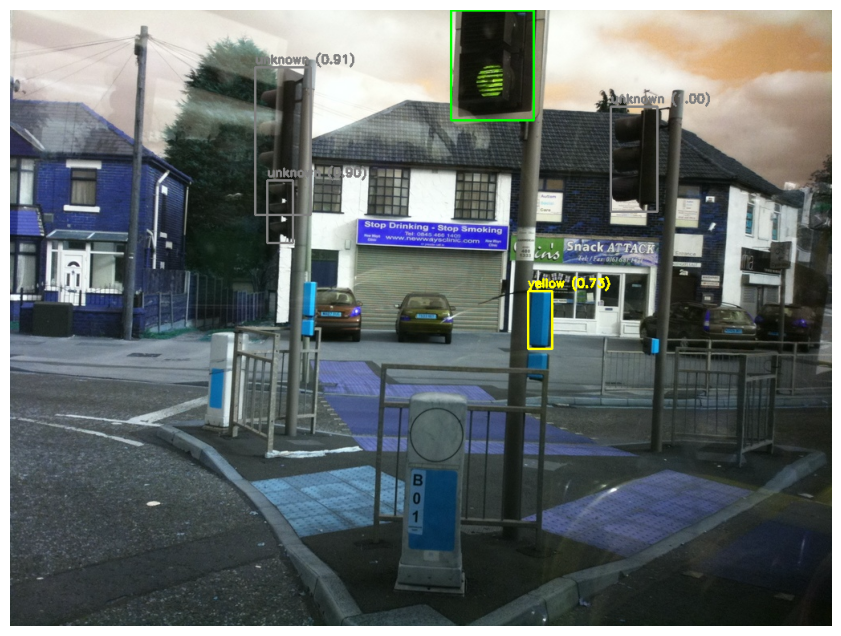

Semáforo #1: unknown (confiança: 1.00) na posição [748, 120, 58, 131]
Semáforo #2: green (confiança: 0.99) na posição [549, 0, 103, 137]
Semáforo #3: unknown (confiança: 0.91) na posição [305, 71, 69, 184]
Semáforo #4: unknown (confiança: 0.90) na posição [320, 212, 32, 78]
Semáforo #5: yellow (confiança: 0.73) na posição [645, 350, 30, 72]


In [22]:
# Exemplo de uso
pipeline = TrafficLightPipeline()
image_path = '../data/images/train/06d0f8d47c411ef2.jpg'
detected_lights = pipeline.process_image(image_path)
pipeline.visualize_results(Image.open(image_path), detected_lights)

# Imprimir resultados
for i, (box, color, score) in enumerate(detected_lights):
    print(f"Semáforo #{i+1}: {color} (confiança: {score:.2f}) na posição {box}")

In [40]:
import cv2
import numpy as np
import torch
import torchvision.transforms as T
from dataclasses import dataclass
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from typing import List, Tuple, Optional

@dataclass
class DetectedTrafficLight:
    """Representa um semáforo detectado na imagem."""
    box: List[int]  # [x, y, w, h]
    color: str
    confidence: float

class TrafficLightDetector:
    """Detector de semáforos usando Faster R-CNN."""
    
    def __init__(self):
        self.model = fasterrcnn_resnet50_fpn(pretrained=True)
        self.model.eval()
        self.transform = T.Compose([T.ToTensor()])
        
    def detect(self, image: Image.Image) -> Tuple[List[List[int]], List[float]]:
        """
        Detecta semáforos na imagem usando Faster R-CNN.
        
        Args:
            image: Imagem PIL
            
        Returns:
            Tuple contendo listas de boxes e scores
        """
        image_tensor = self.transform(image).unsqueeze(0)
        
        with torch.no_grad():
            prediction = self.model(image_tensor)[0]
        
        boxes = []
        scores = []
        
        for box, label, score in zip(prediction['boxes'], 
                                   prediction['labels'], 
                                   prediction['scores']):
            if label == 10 and score > 0.5:  # Classe 10 = semáforo
                x1, y1, x2, y2 = box.tolist()
                w = x2 - x1
                h = y2 - y1
                boxes.append([int(x1), int(y1), int(w), int(h)])
                scores.append(score.item())
                
        return boxes, scores

class TrafficLightColorClassifier:
    """Classifica a cor do semáforo usando processamento de imagem."""
    
    HSV_RANGES = {
        'red1': ([0, 100, 100], [10, 255, 255]),
        'red2': ([160, 100, 100], [180, 255, 255]),
        'yellow': ([15, 100, 100], [35, 255, 255]),
        'green': ([35, 100, 100], [85, 255, 255])
    }
    
    @classmethod
    def classify(cls, image: np.ndarray) -> str:
        """
        Classifica a cor do semáforo usando máscaras HSV.
        
        Args:
            image: Imagem recortada do semáforo
            
        Returns:
            String representando a cor detectada
        """
        hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        height = image.shape[0]
        
        # Criar máscaras para cada cor
        mask_red1 = cv2.inRange(hsv, np.array(cls.HSV_RANGES['red1'][0]), 
                               np.array(cls.HSV_RANGES['red1'][1]))
        mask_red2 = cv2.inRange(hsv, np.array(cls.HSV_RANGES['red2'][0]), 
                               np.array(cls.HSV_RANGES['red2'][1]))
        mask_red = cv2.bitwise_or(mask_red1, mask_red2)
        
        mask_yellow = cv2.inRange(hsv, np.array(cls.HSV_RANGES['yellow'][0]), 
                                np.array(cls.HSV_RANGES['yellow'][1]))
        mask_green = cv2.inRange(hsv, np.array(cls.HSV_RANGES['green'][0]), 
                               np.array(cls.HSV_RANGES['green'][1]))
        
        # Análise por seções verticais
        sections = {
            'red': cv2.countNonZero(mask_red[0:height//3, :]),
            'yellow': cv2.countNonZero(mask_yellow[height//3:2*height//3, :]),
            'green': cv2.countNonZero(mask_green[2*height//3:, :])
        }
        
        threshold = 50
        max_color = max(sections.items(), key=lambda x: x[1])

        print(f"Contagem de pixels: {sections}")
        print(f"Cor detectada: {max_color[0]} com {max_color[1]} pixels")
        
        return max_color[0] if max_color[1] > threshold else 'unknown'

class TrafficLightPipeline:
    """Pipeline completo para detecção e classificação de semáforos."""
    
    def __init__(self):
        self.detector = TrafficLightDetector()
        
    def process_image(self, image_path: str) -> List[DetectedTrafficLight]:
        """
        Processa uma imagem para detectar e classificar semáforos.
        
        Args:
            image_path: Caminho para a imagem
            
        Returns:
            Lista de DetectedTrafficLight
        """
        image = Image.open(image_path)
        image_np = np.array(image)
        
        boxes, scores = self.detector.detect(image)
        detected_lights = []
        
        for box, score in zip(boxes, scores):
            x, y, w, h = box
            margin = 5
            crop = image_np[
                max(0, y-margin):min(image_np.shape[0], y+h+margin),
                max(0, x-margin):min(image_np.shape[1], x+w+margin)
            ]
            
            if crop.size == 0:
                continue
                
            color = TrafficLightColorClassifier.classify(crop)
            detected_lights.append(DetectedTrafficLight(box, color, score))
            
        return detected_lights
    
    def visualize_results(self, image_path: str, detections: List[DetectedTrafficLight]):
        """
        Visualiza os resultados da detecção e classificação.
        
        Args:
            image_path: Caminho para a imagem
            detections: Lista de DetectedTrafficLight
        """
        image = np.array(Image.open(image_path))
        
        # Mapa de cores em RGB (não BGR)
        color_map = {
            'red': (255, 0, 0),      # Vermelho puro
            'yellow': (255, 255, 0),  # Amarelo (vermelho + verde)
            'green': (0, 255, 0),     # Verde puro
            'unknown': (128, 128, 128) # Cinza
        }
        
        for detection in detections:
            x, y, w, h = detection.box
            rgb_color = color_map[detection.color]
            
            # Desenhar retângulo
            cv2.rectangle(
                image, 
                (x, y), 
                (x + w, y + h), 
                (rgb_color[0], rgb_color[1], rgb_color[2]),  # Converter RGB para BGR para o cv2
                2
            )
            
            # Adicionar texto
            text = f"{detection.color} ({detection.confidence:.2f})"
            text_color = (rgb_color[0], rgb_color[1], rgb_color[2])  # Converter RGB para BGR
            cv2.putText(
                image, 
                text, 
                (x, y - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 
                0.5, 
                text_color, 
                2
            )
        
        # Mostrar a imagem em RGB
        plt.figure(figsize=(12, 8))
        plt.imshow(image)  # Não precisa converter, pois a imagem já está em RGB
        plt.axis('off')
        plt.show()

Contagem de pixels: {'red': 147, 'yellow': 33, 'green': 0}
Cor detectada: red com 147 pixels
Contagem de pixels: {'red': 0, 'yellow': 131, 'green': 0}
Cor detectada: yellow com 131 pixels
Contagem de pixels: {'red': 0, 'yellow': 639, 'green': 0}
Cor detectada: yellow com 639 pixels
Contagem de pixels: {'red': 18, 'yellow': 15, 'green': 0}
Cor detectada: red com 18 pixels
Contagem de pixels: {'red': 16, 'yellow': 23, 'green': 0}
Cor detectada: yellow com 23 pixels
Contagem de pixels: {'red': 0, 'yellow': 30, 'green': 0}
Cor detectada: yellow com 30 pixels
Contagem de pixels: {'red': 7, 'yellow': 590, 'green': 0}
Cor detectada: yellow com 590 pixels
Contagem de pixels: {'red': 1, 'yellow': 0, 'green': 0}
Cor detectada: red com 1 pixels
Contagem de pixels: {'red': 0, 'yellow': 41, 'green': 0}
Cor detectada: yellow com 41 pixels
Contagem de pixels: {'red': 0, 'yellow': 58, 'green': 0}
Cor detectada: yellow com 58 pixels
Contagem de pixels: {'red': 9, 'yellow': 139, 'green': 0}
Cor detectad

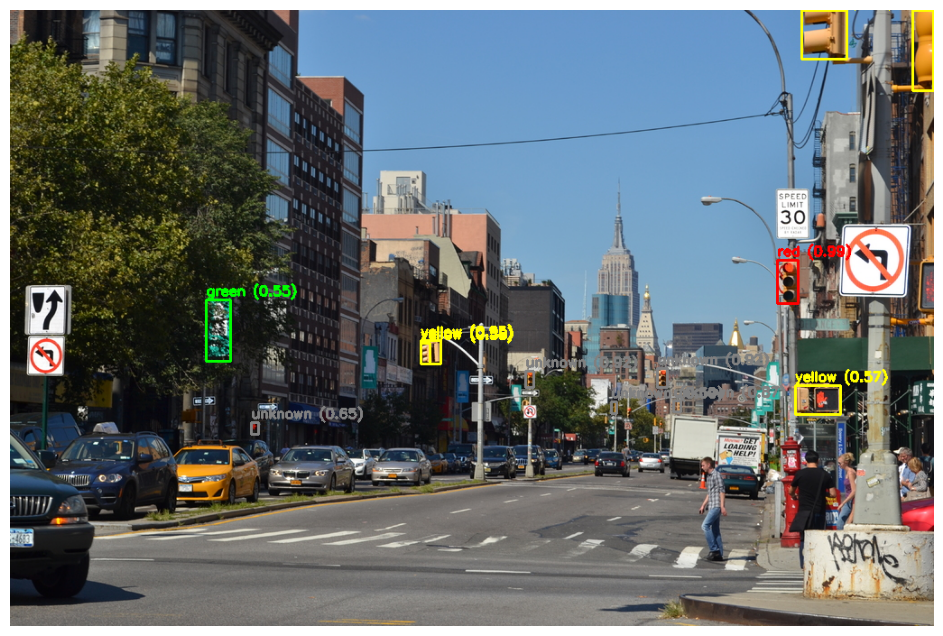

Semáforo #1: red (confiança: 0.99) na posição [850, 277, 23, 48]
Semáforo #2: yellow (confiança: 0.95) na posição [455, 366, 22, 26]
Semáforo #3: yellow (confiança: 0.94) na posição [877, 0, 50, 54]
Semáforo #4: unknown (confiança: 0.92) na posição [717, 397, 11, 21]
Semáforo #5: unknown (confiança: 0.92) na posição [571, 400, 9, 18]
Semáforo #6: unknown (confiança: 0.87) na posição [735, 433, 8, 12]
Semáforo #7: yellow (confiança: 0.80) na posição [1000, 0, 23, 89]
Semáforo #8: unknown (confiança: 0.65) na posição [267, 457, 8, 13]
Semáforo #9: unknown (confiança: 0.59) na posição [666, 434, 6, 13]
Semáforo #10: yellow (confiança: 0.58) na posição [455, 369, 10, 23]
Semáforo #11: yellow (confiança: 0.57) na posição [870, 416, 50, 32]
Semáforo #12: green (confiança: 0.55) na posição [217, 321, 27, 68]


In [41]:
pipeline = TrafficLightPipeline()

image_path = '../data/images/train/0112ebee9638ecf1.jpg'

detected_lights = pipeline.process_image(image_path)
# Adicionar verificação para resultados detectados
if detected_lights:
    pipeline.visualize_results(image_path, detected_lights)
    # Imprimir resultados
    for i, detection in enumerate(detected_lights):
        print(f"Semáforo #{i+1}: {detection.color} (confiança: {detection.confidence:.2f}) na posição {detection.box}")
else:
    print("Nenhum semáforo detectado.")


/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/erlo/Documents/Code/dl-projeto-final/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


../data/images/train/0932708a398a5d3f.jpg


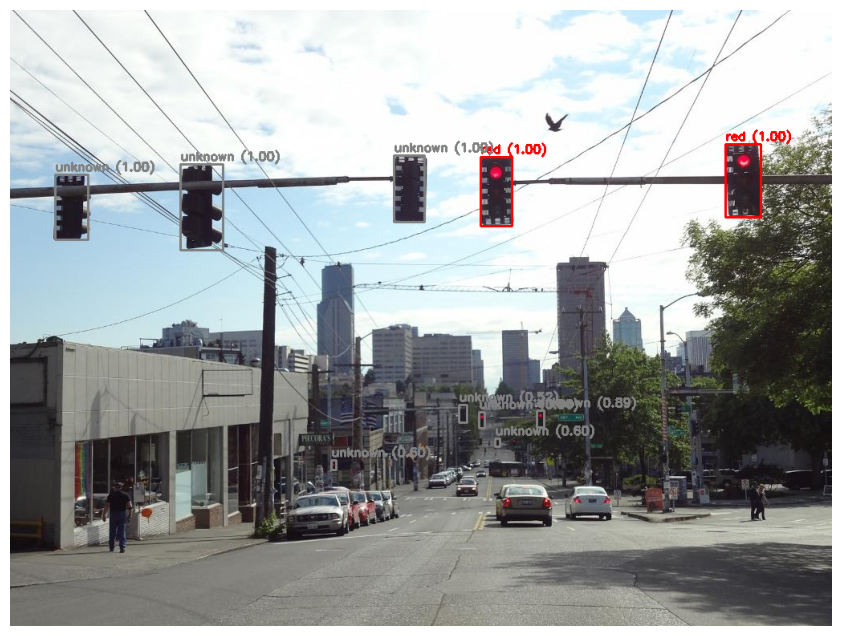

Semáforo #1: red (confiança: 1.00) na posição [586, 183, 39, 86]
Semáforo #2: unknown (confiança: 1.00) na posição [478, 181, 38, 83]
Semáforo #3: unknown (confiança: 1.00) na posição [212, 192, 53, 107]
Semáforo #4: red (confiança: 1.00) na posição [891, 167, 44, 91]
Semáforo #5: unknown (confiança: 1.00) na posição [56, 205, 41, 81]
Semáforo #6: unknown (confiança: 0.96) na posição [584, 501, 7, 20]
Semáforo #7: unknown (confiança: 0.89) na posição [656, 499, 9, 21]
Semáforo #8: unknown (confiança: 0.60) na posição [400, 561, 6, 12]
Semáforo #9: unknown (confiança: 0.60) na posição [604, 534, 6, 10]
Semáforo #10: unknown (confiança: 0.52) na posição [559, 492, 10, 22]
../data/images/train/055b8f4762ee71e3.jpg


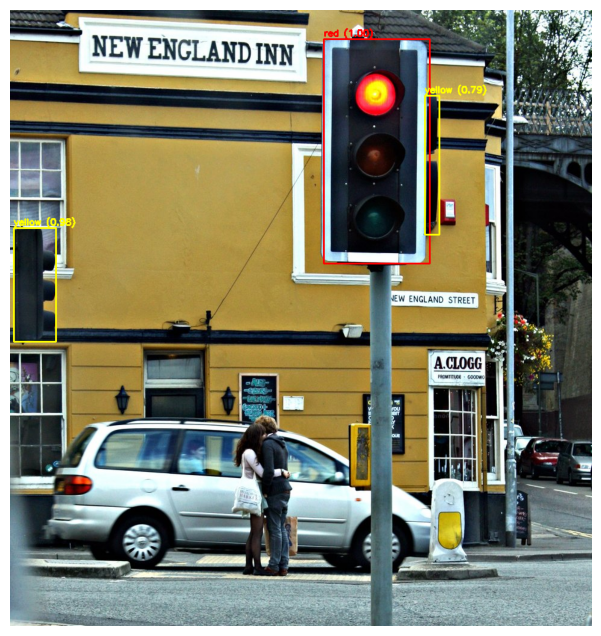

Semáforo #1: red (confiança: 1.00) na posição [521, 48, 176, 373]
Semáforo #2: yellow (confiança: 0.98) na posição [6, 362, 70, 189]
Semáforo #3: yellow (confiança: 0.79) na posição [689, 142, 24, 231]
../data/images/train/03cb96045c9ee90e.jpg


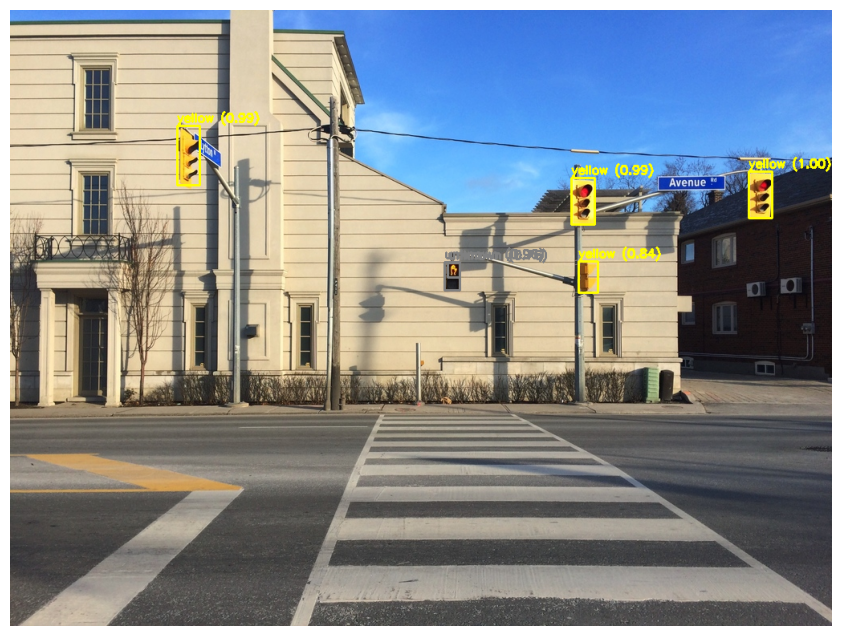

Semáforo #1: yellow (confiança: 1.00) na posição [920, 201, 29, 58]
Semáforo #2: yellow (confiança: 0.99) na posição [208, 144, 28, 74]
Semáforo #3: yellow (confiança: 0.99) na posição [699, 209, 29, 58]
Semáforo #4: unknown (confiança: 0.96) na posição [541, 314, 19, 35]
Semáforo #5: yellow (confiança: 0.84) na posição [708, 313, 24, 39]
Semáforo #6: unknown (confiança: 0.76) na posição [545, 315, 15, 18]
../data/images/train/0100533625296ddb.jpg


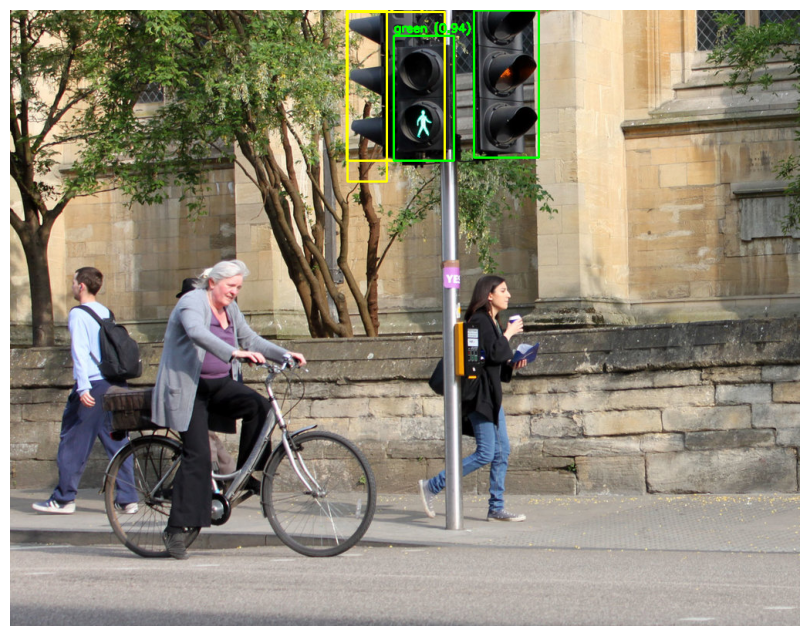

Semáforo #1: green (confiança: 1.00) na posição [601, 0, 84, 191]
Semáforo #2: yellow (confiança: 0.95) na posição [436, 2, 127, 193]
Semáforo #3: green (confiança: 0.94) na posição [497, 33, 78, 162]
Semáforo #4: yellow (confiança: 0.75) na posição [437, 0, 51, 222]
../data/images/train/07c8db8d097e076e.jpg


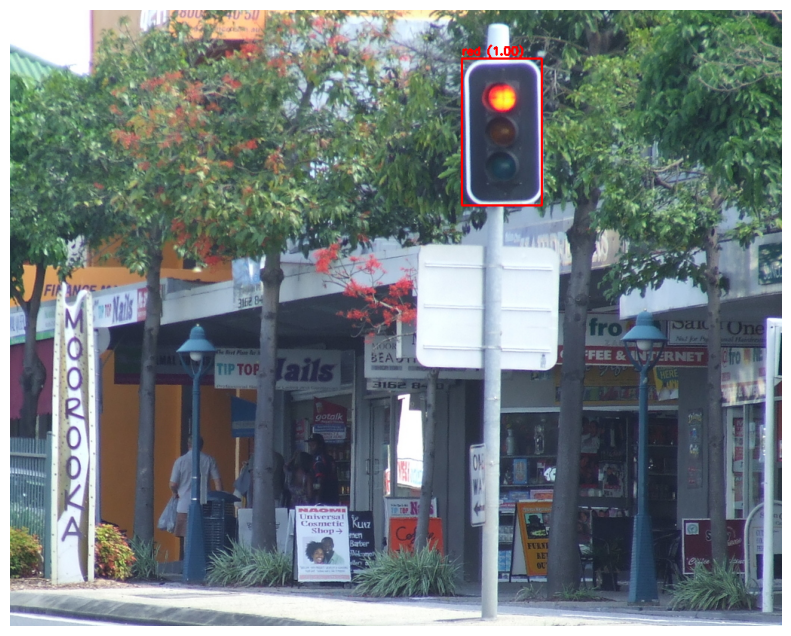

Semáforo #1: red (confiança: 1.00) na posição [599, 64, 106, 195]
../data/images/train/07cb2a4dae0376b9.jpg


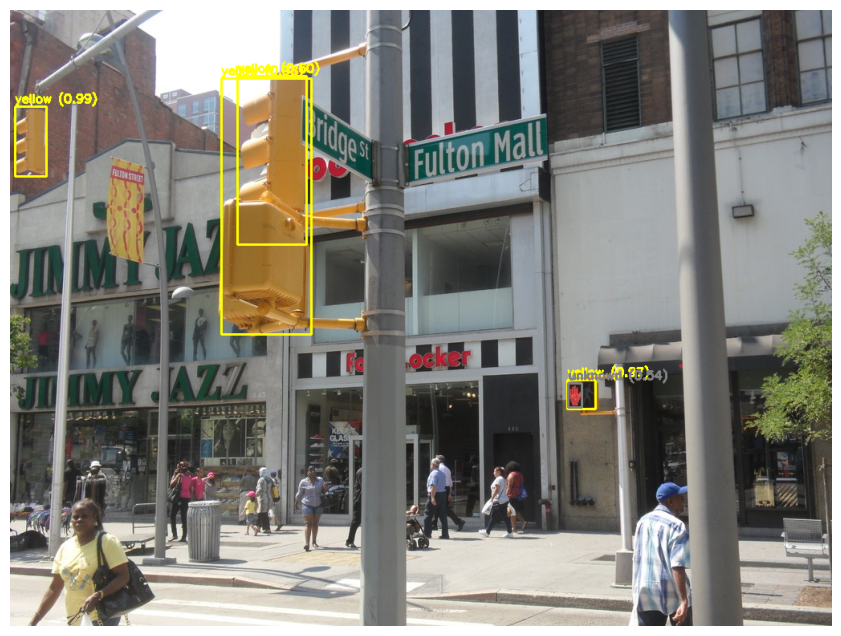

Semáforo #1: yellow (confiança: 0.99) na posição [6, 120, 39, 87]
Semáforo #2: yellow (confiança: 0.98) na posição [263, 85, 112, 319]
Semáforo #3: yellow (confiança: 0.97) na posição [694, 461, 35, 36]
Semáforo #4: yellow (confiança: 0.60) na posição [283, 82, 86, 210]
Semáforo #5: unknown (confiança: 0.54) na posição [695, 465, 17, 30]
../data/images/train/004046e04f244025.jpg


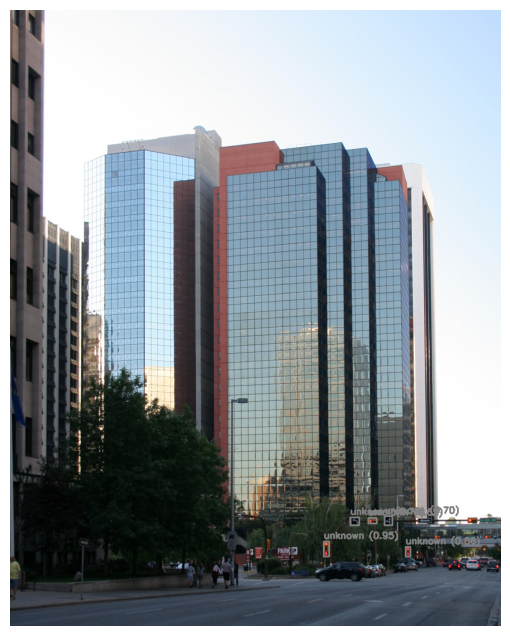

Semáforo #1: unknown (confiança: 0.95) na posição [521, 883, 9, 25]
Semáforo #2: unknown (confiança: 0.86) na posição [657, 892, 8, 16]
Semáforo #3: unknown (confiança: 0.72) na posição [565, 843, 15, 13]
Semáforo #4: unknown (confiança: 0.70) na posição [622, 841, 13, 15]
Semáforo #5: unknown (confiança: 0.65) na posição [595, 844, 14, 9]
../data/images/train/07f1d3d4d7db0389.jpg


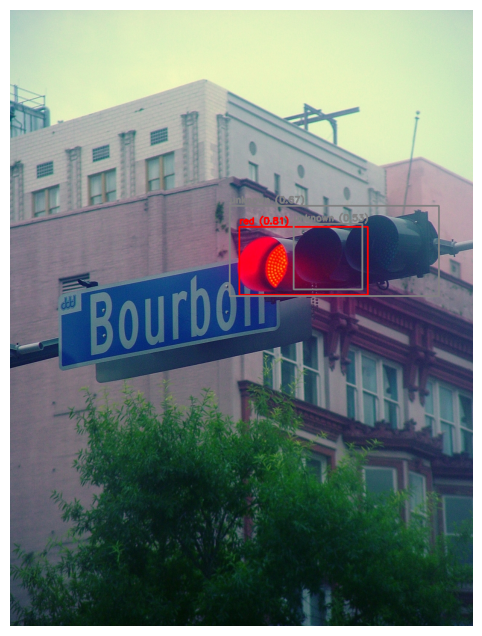

Semáforo #1: red (confiança: 0.81) na posição [380, 360, 213, 113]
Semáforo #2: unknown (confiança: 0.67) na posição [364, 325, 347, 150]
Semáforo #3: unknown (confiança: 0.53) na posição [470, 355, 114, 109]
../data/images/train/0955eb7533c94dd4.jpg


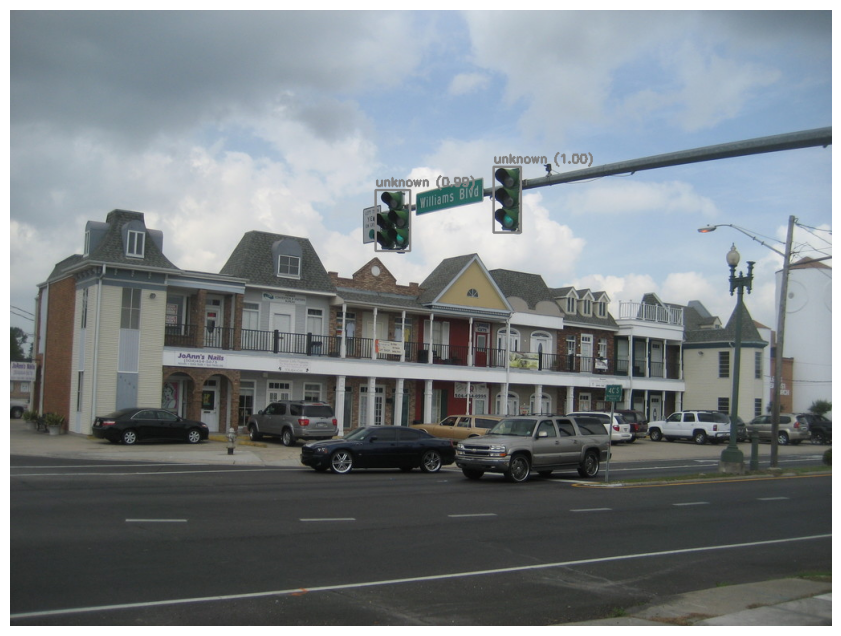

Semáforo #1: unknown (confiança: 1.00) na posição [602, 195, 34, 82]
Semáforo #2: unknown (confiança: 0.99) na posição [455, 224, 43, 76]
../data/images/train/06bc73d8150f3839.jpg


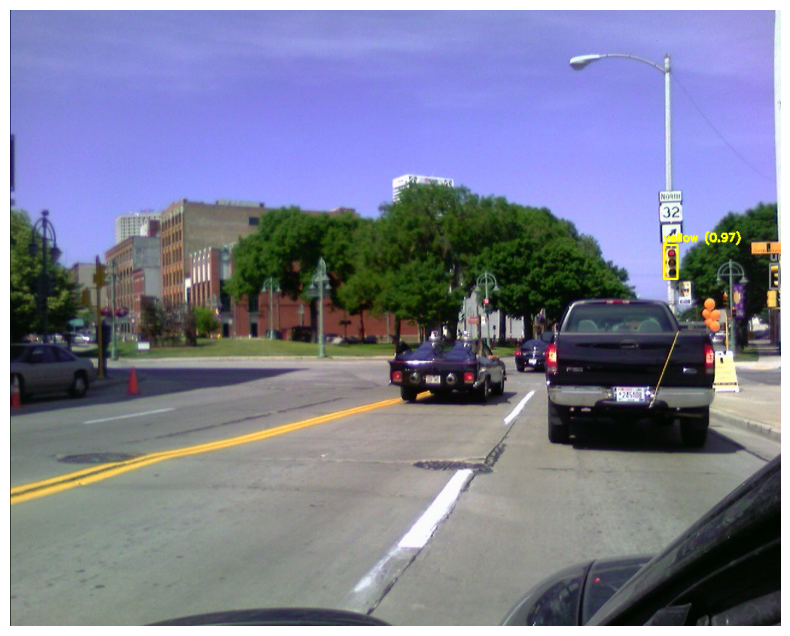

Semáforo #1: yellow (confiança: 0.97) na posição [868, 312, 18, 45]
Semáforo #2: unknown (confiança: 0.52) na posição [1009, 337, 12, 33]
../data/images/train/01e4eb5fa4c0bb42.jpg


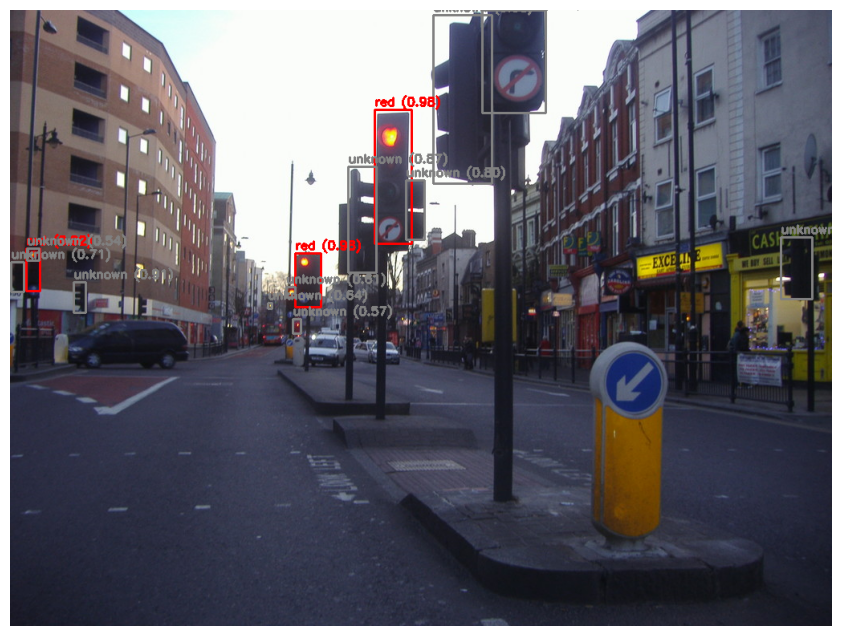

Semáforo #1: unknown (confiança: 0.98) na posição [527, 6, 73, 210]
Semáforo #2: red (confiança: 0.98) na posição [454, 124, 46, 167]
Semáforo #3: red (confiança: 0.98) na posição [355, 303, 32, 67]
Semáforo #4: unknown (confiança: 0.96) na posição [960, 283, 39, 77]
Semáforo #5: red (confiança: 0.92) na posição [20, 297, 17, 53]
Semáforo #6: unknown (confiança: 0.91) na posição [79, 339, 15, 38]
Semáforo #7: unknown (confiança: 0.87) na posição [421, 195, 35, 132]
Semáforo #8: unknown (confiança: 0.80) na posição [588, 0, 79, 128]
Semáforo #9: unknown (confiança: 0.80) na posição [493, 212, 23, 74]
Semáforo #10: unknown (confiança: 0.71) na posição [1, 314, 16, 37]
Semáforo #11: unknown (confiança: 0.64) na posição [321, 365, 5, 7]
Semáforo #12: unknown (confiança: 0.61) na posição [344, 345, 11, 13]
Semáforo #13: unknown (confiança: 0.57) na posição [352, 385, 10, 18]
Semáforo #14: unknown (confiança: 0.54) na posição [21, 297, 15, 15]
../data/images/train/081c7365d8d1cf0d.jpg


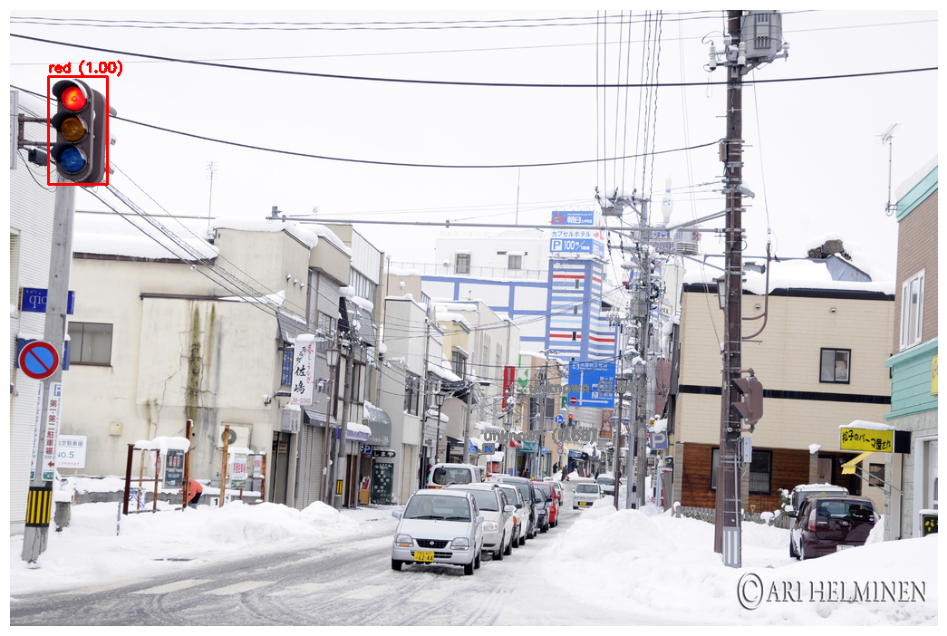

Semáforo #1: red (confiança: 1.00) na posição [42, 73, 65, 119]
Semáforo #2: unknown (confiança: 0.64) na posição [572, 426, 14, 39]
Semáforo #3: unknown (confiança: 0.58) na posição [522, 479, 11, 10]
../data/images/train/00231e95cab3740e.jpg


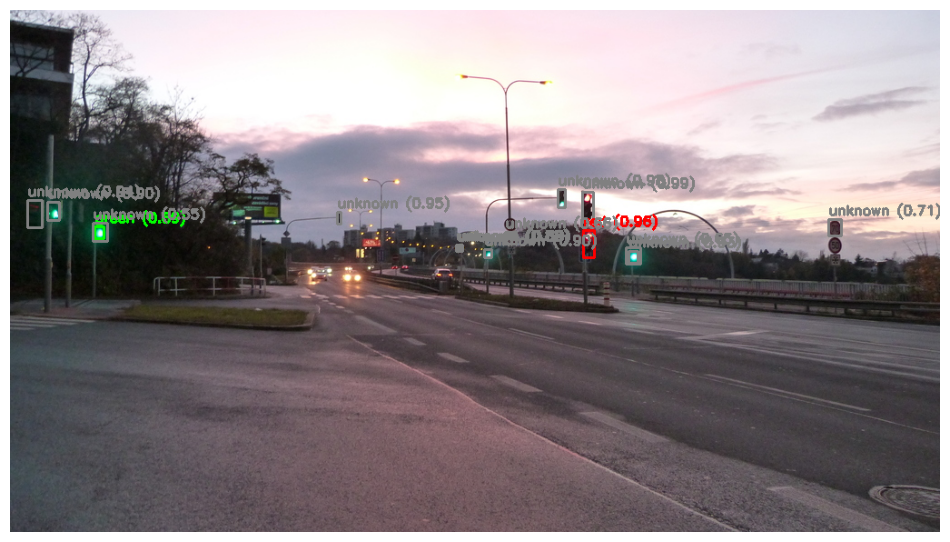

Semáforo #1: unknown (confiança: 0.99) na posição [630, 201, 12, 33]
Semáforo #2: unknown (confiança: 0.98) na posição [603, 198, 8, 20]
Semáforo #3: red (confiança: 0.96) na posição [631, 243, 12, 30]
Semáforo #4: unknown (confiança: 0.95) na posição [360, 223, 4, 13]
Semáforo #5: unknown (confiança: 0.94) na posição [19, 210, 16, 30]
Semáforo #6: unknown (confiança: 0.93) na posição [681, 266, 10, 13]
Semáforo #7: unknown (confiança: 0.90) na posição [41, 212, 13, 20]
Semáforo #8: unknown (confiança: 0.90) na posição [522, 264, 8, 9]
Semáforo #9: green (confiança: 0.89) na posição [93, 239, 10, 13]
Semáforo #10: unknown (confiança: 0.82) na posição [491, 259, 4, 7]
Semáforo #11: unknown (confiança: 0.71) na posição [901, 231, 14, 18]
Semáforo #12: unknown (confiança: 0.66) na posição [545, 245, 12, 13]
Semáforo #13: unknown (confiança: 0.65) na posição [678, 262, 16, 18]
Semáforo #14: unknown (confiança: 0.60) na posição [493, 259, 5, 7]
Semáforo #15: unknown (confiança: 0.55) na pos

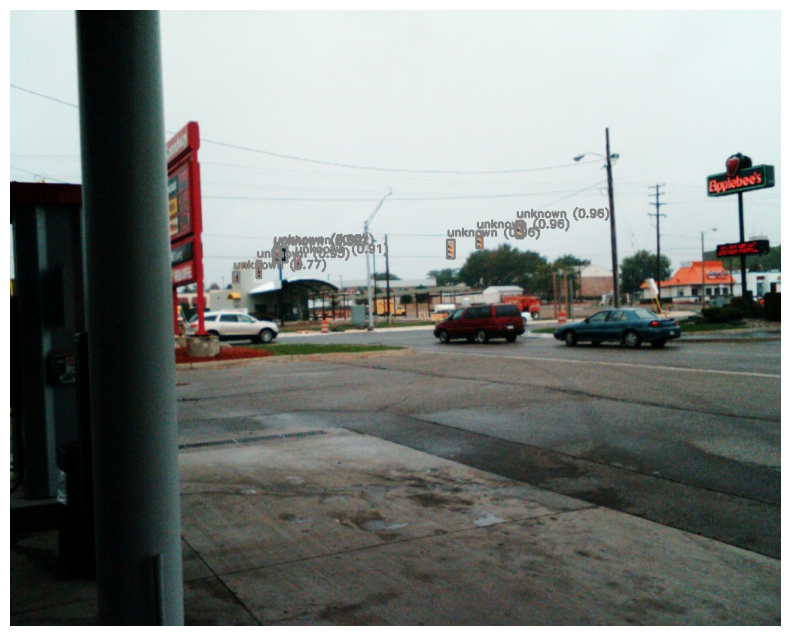

Semáforo #1: unknown (confiança: 0.96) na posição [672, 280, 9, 23]
Semáforo #2: unknown (confiança: 0.96) na posição [580, 305, 10, 25]
Semáforo #3: unknown (confiança: 0.96) na posição [619, 294, 8, 22]
Semáforo #4: unknown (confiança: 0.95) na posição [327, 333, 6, 23]
Semáforo #5: unknown (confiança: 0.92) na posição [359, 315, 8, 20]
Semáforo #6: unknown (confiança: 0.91) na posição [378, 327, 7, 17]
Semáforo #7: unknown (confiança: 0.90) na posição [350, 314, 18, 21]
Semáforo #8: unknown (confiança: 0.77) na posição [296, 348, 8, 14]
Semáforo #9: unknown (confiança: 0.56) na posição [349, 317, 9, 19]
../data/images/train/044cacf2fb8c0911.jpg


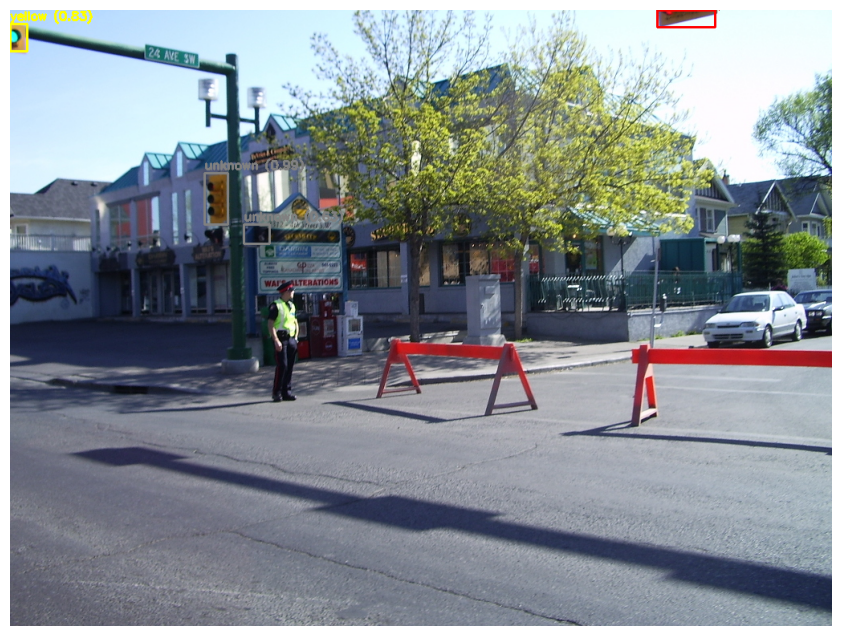

Semáforo #1: unknown (confiança: 0.99) na posição [242, 203, 29, 64]
Semáforo #2: yellow (confiança: 0.83) na posição [0, 17, 21, 34]
Semáforo #3: red (confiança: 0.78) na posição [806, 0, 72, 21]
Semáforo #4: unknown (confiança: 0.63) na posição [291, 267, 32, 24]
../data/images/train/01248f94edf92e02.jpg


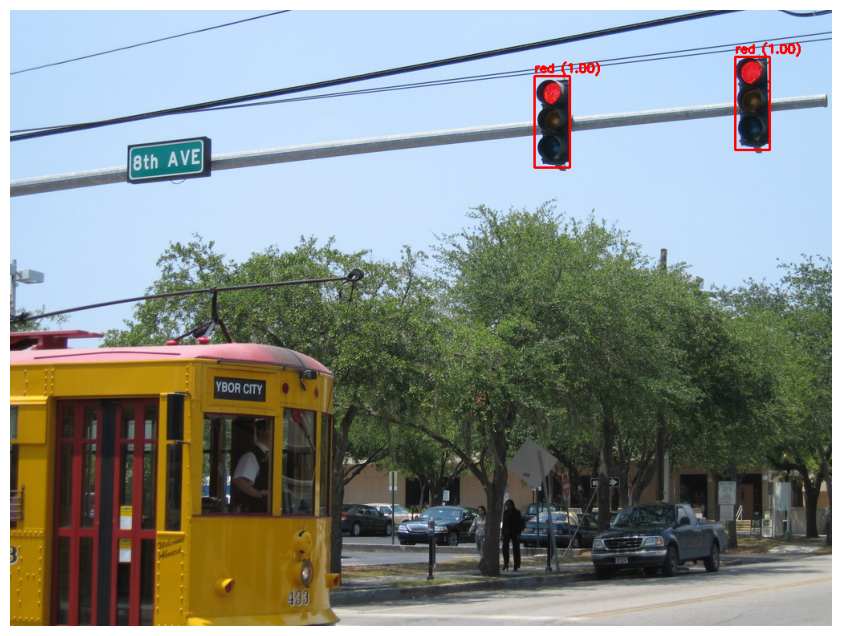

Semáforo #1: red (confiança: 1.00) na posição [903, 58, 43, 116]
Semáforo #2: red (confiança: 1.00) na posição [653, 82, 44, 114]
../data/images/train/06bf02123ee6a511.jpg


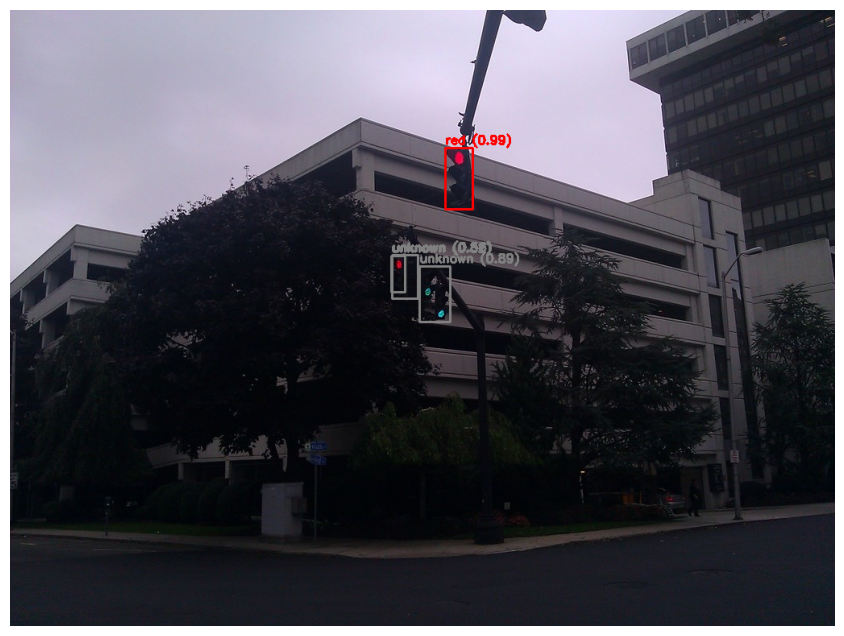

Semáforo #1: red (confiança: 0.99) na posição [540, 171, 34, 76]
Semáforo #2: unknown (confiança: 0.89) na posição [508, 318, 38, 69]
Semáforo #3: unknown (confiança: 0.82) na posição [473, 305, 17, 45]
Semáforo #4: unknown (confiança: 0.56) na posição [474, 304, 32, 54]
../data/images/train/0002f04bed7a3d76.jpg


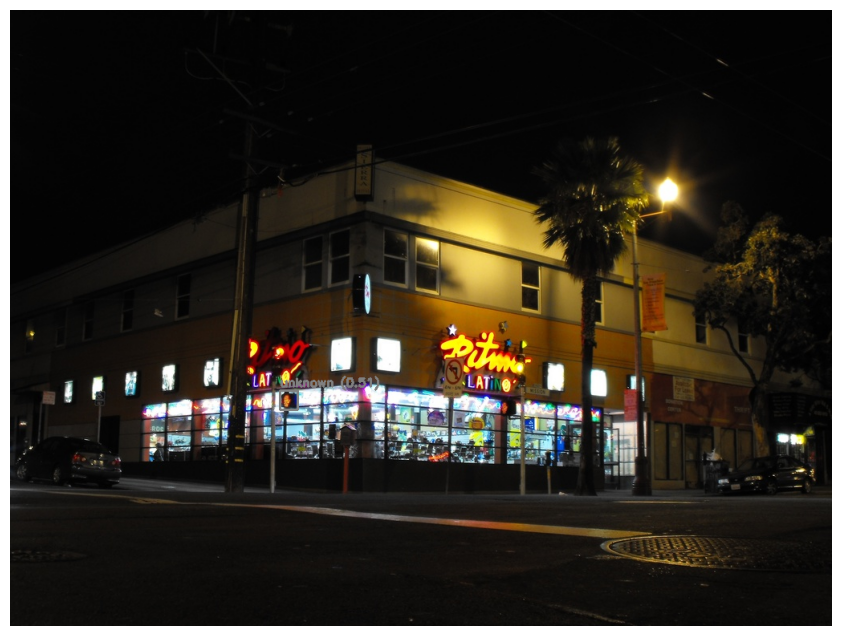

Semáforo #1: unknown (confiança: 0.51) na posição [336, 474, 22, 24]
../data/images/train/011c16a034b2e73c.jpg


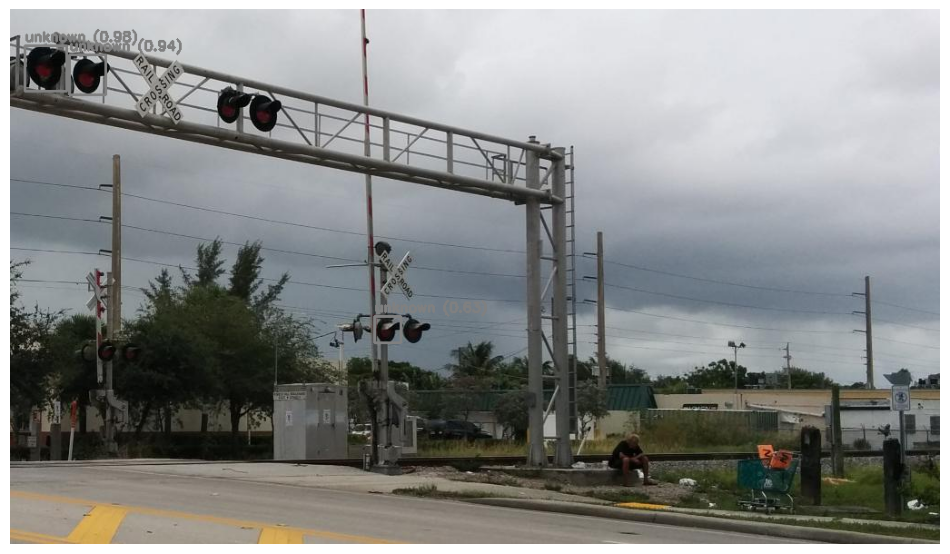

Semáforo #1: unknown (confiança: 0.98) na posição [16, 40, 46, 50]
Semáforo #2: unknown (confiança: 0.94) na posição [65, 50, 40, 44]
Semáforo #3: unknown (confiança: 0.63) na posição [401, 338, 29, 29]
../data/images/train/090aa2c685cfa8e2.jpg


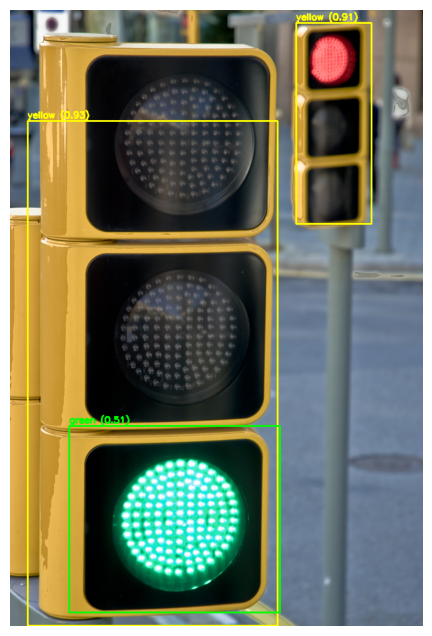

Semáforo #1: yellow (confiança: 0.93) na posição [29, 184, 415, 839]
Semáforo #2: yellow (confiança: 0.91) na posição [475, 21, 125, 334]
Semáforo #3: green (confiança: 0.51) na posição [98, 691, 350, 310]
../data/images/train/05fab8d9991ca41c.jpg


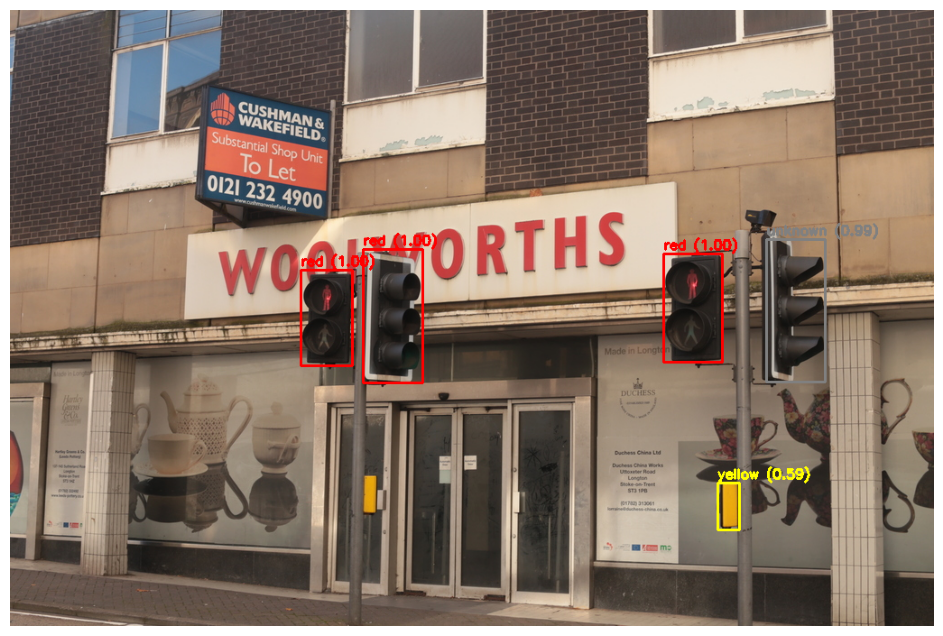

Semáforo #1: red (confiança: 1.00) na posição [724, 270, 65, 120]
Semáforo #2: red (confiança: 1.00) na posição [391, 265, 66, 148]
Semáforo #3: red (confiança: 1.00) na posição [322, 288, 57, 106]
Semáforo #4: unknown (confiança: 0.99) na posição [838, 254, 65, 158]
Semáforo #5: yellow (confiança: 0.59) na posição [784, 524, 24, 52]
../data/images/train/025f9021f50def62.jpg


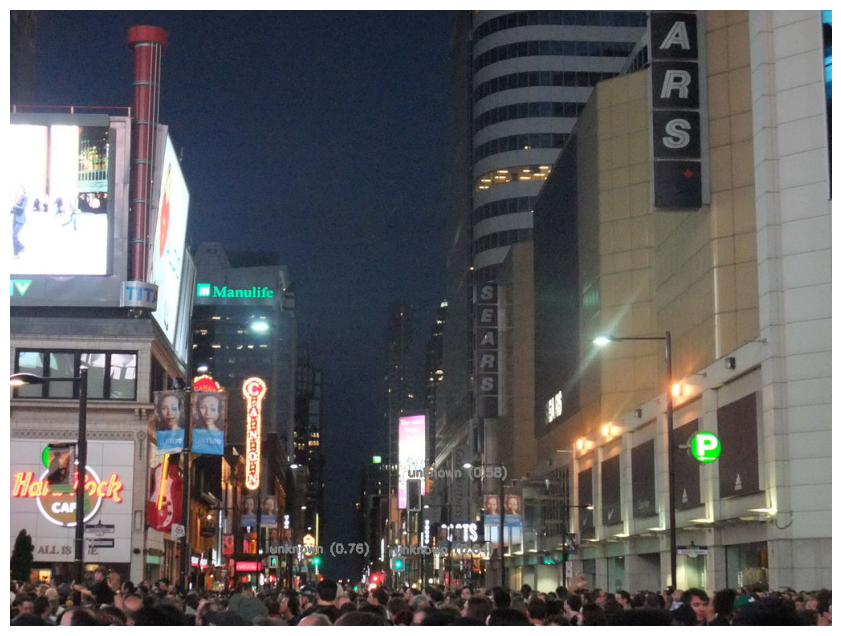

Semáforo #1: unknown (confiança: 0.76) na posição [323, 681, 9, 13]
Semáforo #2: unknown (confiança: 0.64) na posição [478, 682, 12, 16]
Semáforo #3: unknown (confiança: 0.58) na posição [495, 586, 15, 37]
../data/images/train/08539f255801e98c.jpg


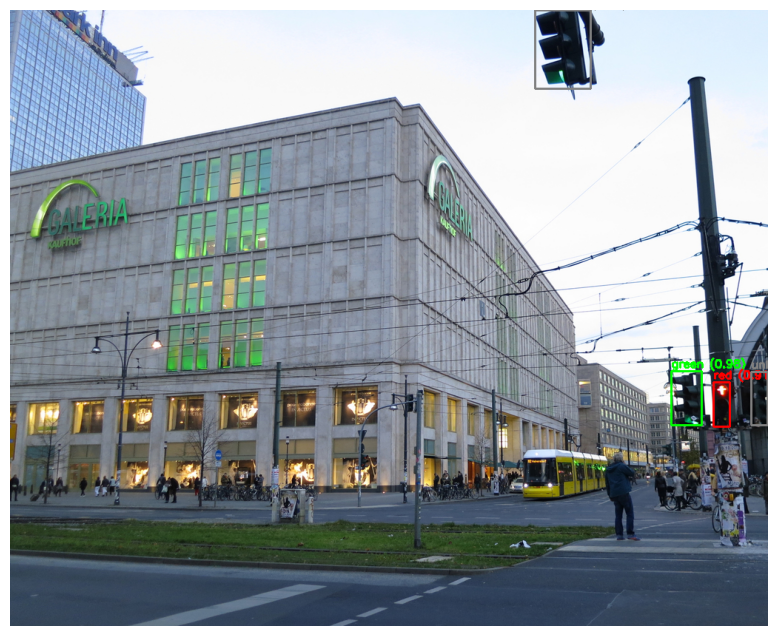

Semáforo #1: unknown (confiança: 0.99) na posição [709, 0, 75, 106]
Semáforo #2: green (confiança: 0.98) na posição [893, 488, 41, 73]
Semáforo #3: red (confiança: 0.91) na posição [950, 503, 22, 60]
Semáforo #4: unknown (confiança: 0.77) na posição [1001, 489, 22, 72]
../data/images/train/0270b3f501a0f3a8.jpg


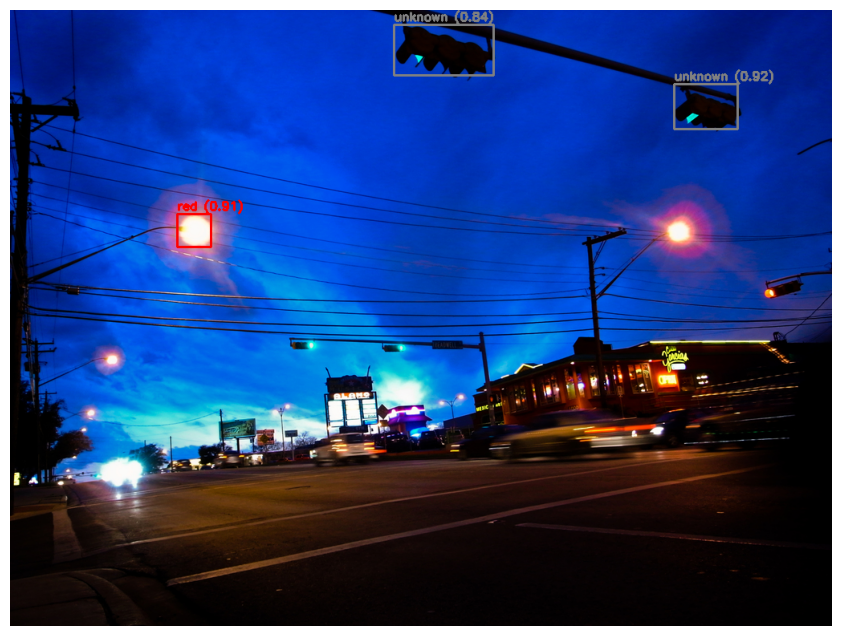

Semáforo #1: unknown (confiança: 0.92) na posição [827, 92, 79, 56]
Semáforo #2: red (confiança: 0.91) na posição [208, 254, 42, 41]
Semáforo #3: unknown (confiança: 0.84) na posição [478, 18, 124, 63]
../data/images/train/032414d60b7aafc9.jpg


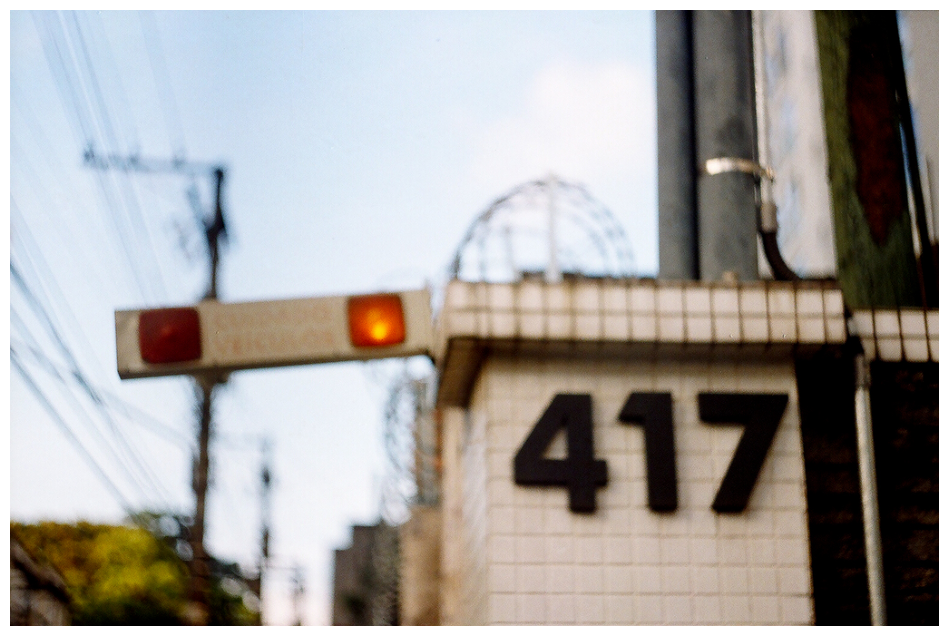

../data/images/train/03dfeb0cd5d2fc01.jpg


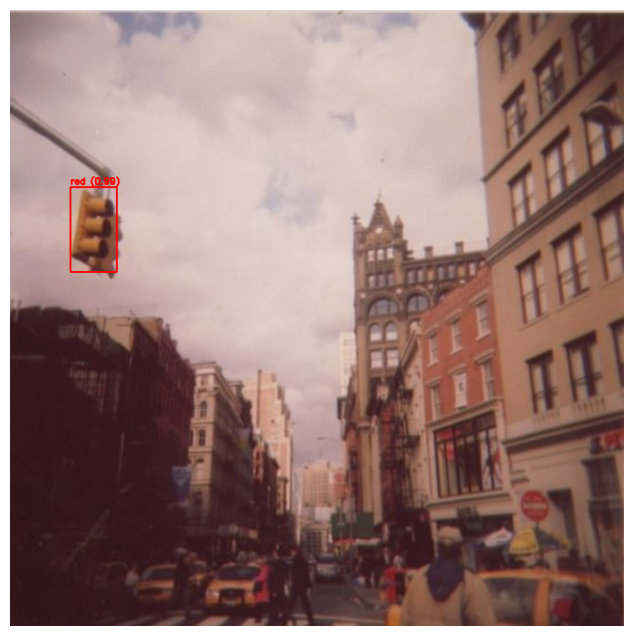

Semáforo #1: red (confiança: 0.99) na posição [100, 294, 77, 141]
../data/images/train/0026d0c5a6d3c67e.jpg


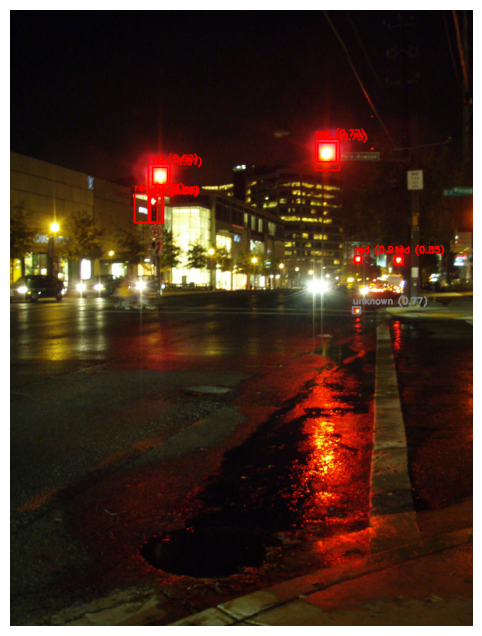

Semáforo #1: red (confiança: 0.91) na posição [571, 408, 11, 11]
Semáforo #2: red (confiança: 0.86) na posição [229, 310, 15, 43]
Semáforo #3: red (confiança: 0.85) na posição [638, 408, 13, 15]
Semáforo #4: red (confiança: 0.81) na posição [236, 261, 25, 29]
Semáforo #5: red (confiança: 0.77) na posição [206, 305, 45, 48]
Semáforo #6: unknown (confiança: 0.77) na posição [568, 493, 13, 11]
Semáforo #7: red (confiança: 0.73) na posição [510, 220, 31, 32]
Semáforo #8: red (confiança: 0.72) na posição [506, 214, 40, 52]
Semáforo #9: red (confiança: 0.62) na posição [229, 256, 36, 49]
Semáforo #10: red (confiança: 0.55) na posição [232, 309, 22, 45]
../data/images/train/02cca0b5f4ea859b.jpg


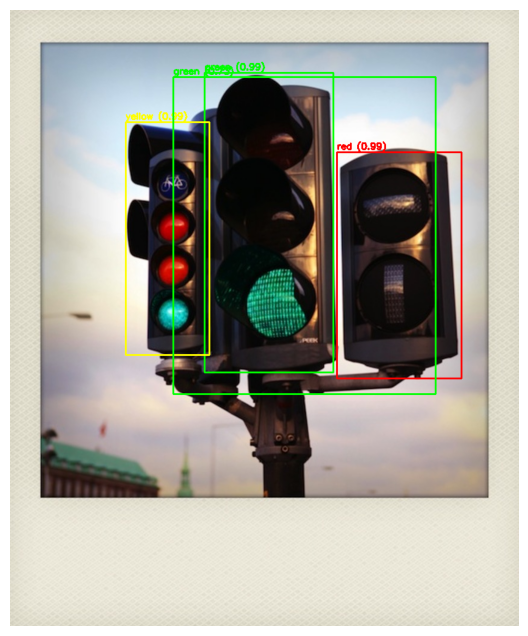

Semáforo #1: red (confiança: 0.99) na posição [543, 236, 207, 376]
Semáforo #2: green (confiança: 0.99) na posição [323, 104, 214, 498]
Semáforo #3: yellow (confiança: 0.99) na posição [192, 186, 139, 387]
Semáforo #4: green (confiança: 0.73) na posição [271, 111, 436, 527]
../data/images/train/059d16d46a929bda.jpg


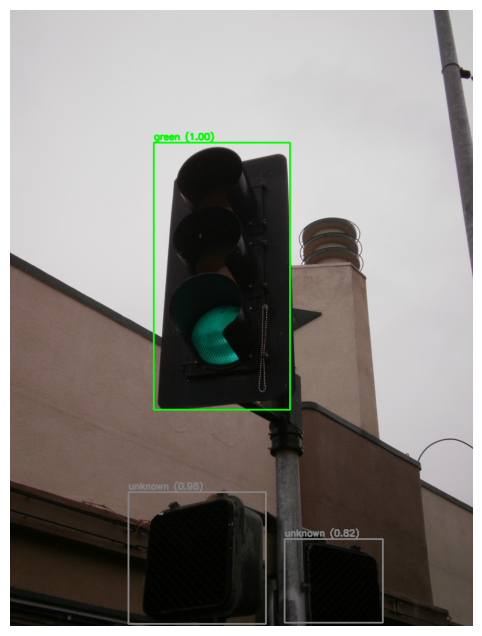

Semáforo #1: green (confiança: 1.00) na posição [238, 220, 226, 444]
Semáforo #2: unknown (confiança: 0.98) na posição [196, 801, 228, 219]
Semáforo #3: unknown (confiança: 0.82) na posição [455, 879, 163, 139]
../data/images/train/037db65d7db752dd.jpg


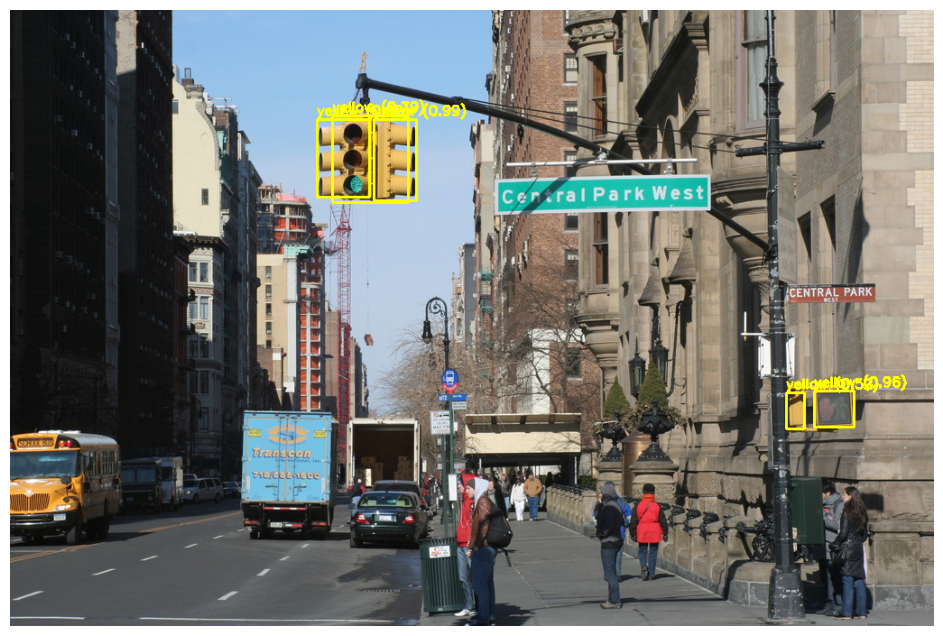

Semáforo #1: yellow (confiança: 0.99) na posição [403, 121, 47, 90]
Semáforo #2: yellow (confiança: 0.96) na posição [891, 422, 44, 40]
Semáforo #3: yellow (confiança: 0.96) na posição [340, 121, 58, 86]
Semáforo #4: yellow (confiança: 0.79) na posição [357, 117, 84, 96]
Semáforo #5: yellow (confiança: 0.52) na posição [860, 424, 20, 40]
../data/images/train/04cdbe5d2100cd12.jpg


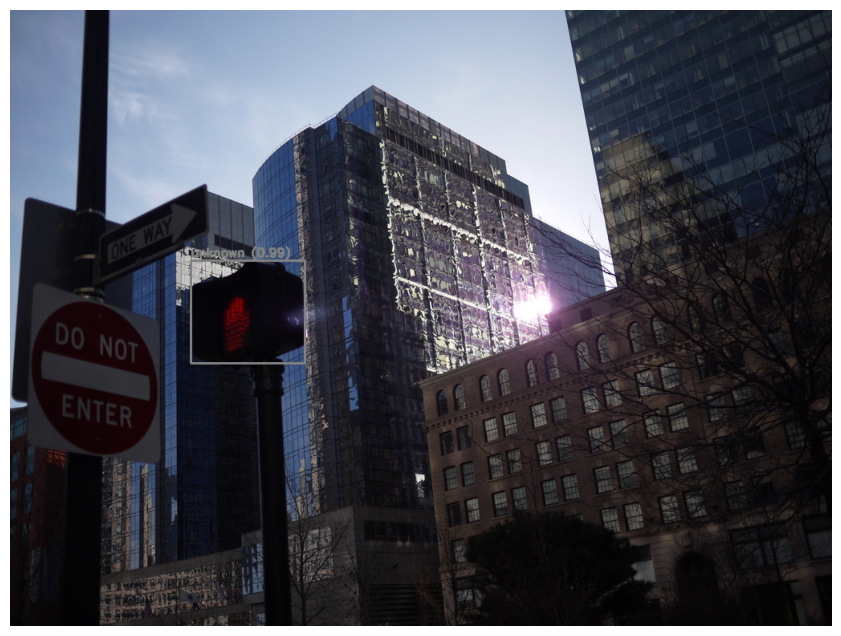

Semáforo #1: unknown (confiança: 0.99) na posição [225, 312, 142, 128]
../data/images/train/00540dc66af81e94.jpg


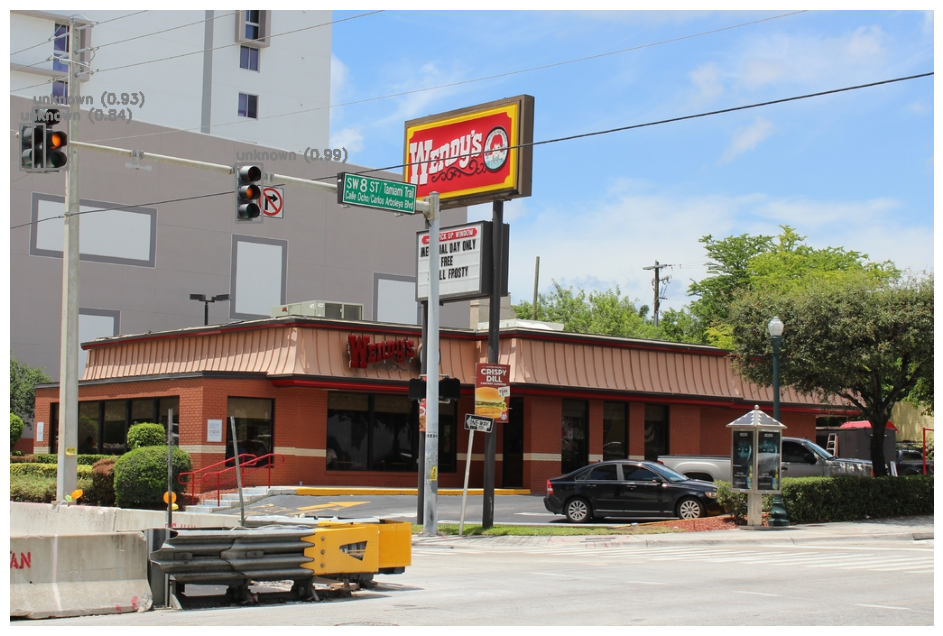

Semáforo #1: unknown (confiança: 0.99) na posição [250, 170, 29, 65]
Semáforo #2: unknown (confiança: 0.93) na posição [25, 108, 39, 68]
Semáforo #3: unknown (confiança: 0.84) na posição [11, 126, 27, 51]
../data/images/train/07fe3e1ff72959ef.jpg


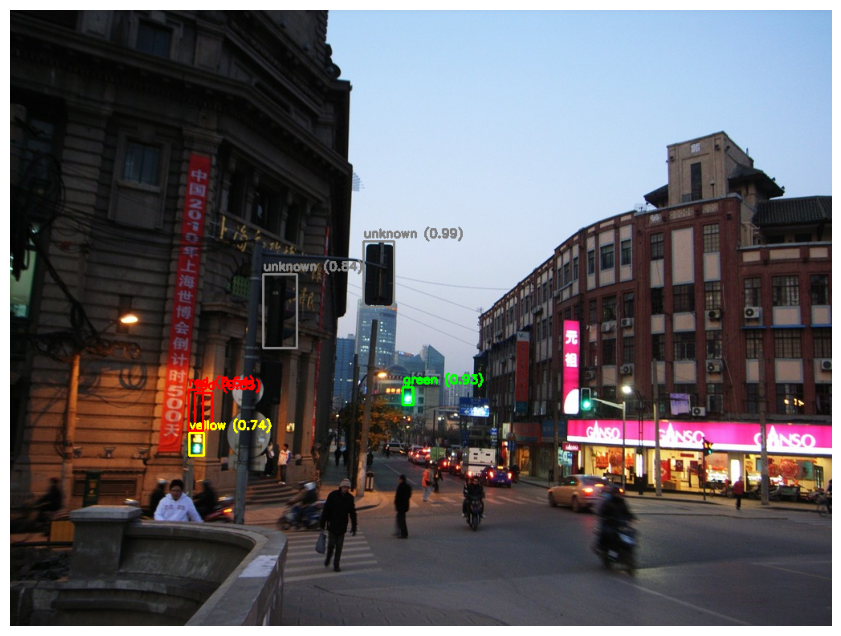

Semáforo #1: unknown (confiança: 0.99) na posição [440, 288, 38, 82]
Semáforo #2: green (confiança: 0.93) na posição [489, 470, 13, 22]
Semáforo #3: red (confiança: 0.85) na posição [230, 477, 21, 45]
Semáforo #4: unknown (confiança: 0.84) na posição [315, 329, 42, 92]
Semáforo #5: yellow (confiança: 0.74) na posição [223, 527, 18, 28]
Semáforo #6: red (confiança: 0.64) na posição [222, 473, 18, 51]
../data/images/train/02d523d8378da5d1.jpg


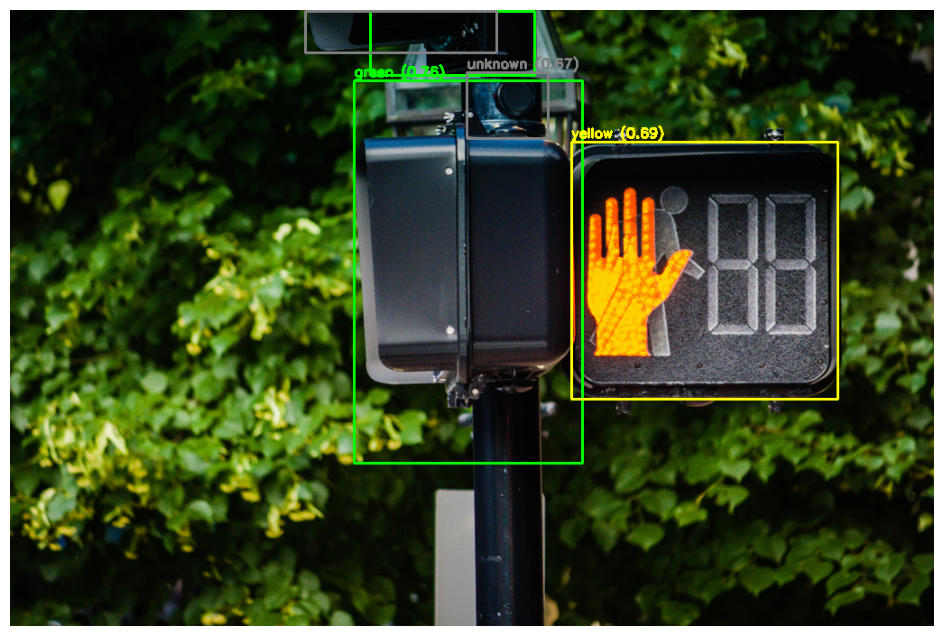

Semáforo #1: green (confiança: 0.92) na posição [399, 1, 182, 71]
Semáforo #2: green (confiança: 0.76) na posição [381, 78, 253, 424]
Semáforo #3: unknown (confiança: 0.71) na posição [327, 1, 212, 46]
Semáforo #4: yellow (confiança: 0.69) na posição [622, 146, 295, 285]
Semáforo #5: unknown (confiança: 0.67) na posição [506, 69, 90, 73]
../data/images/train/034170942c1d09f8.jpg


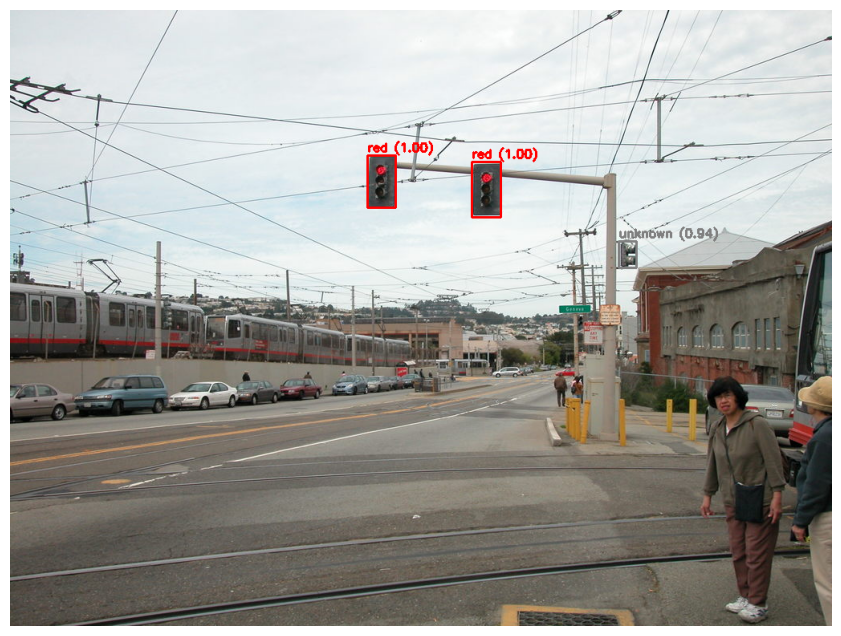

Semáforo #1: red (confiança: 1.00) na posição [445, 181, 35, 65]
Semáforo #2: red (confiança: 1.00) na posição [575, 189, 36, 69]
Semáforo #3: unknown (confiança: 0.94) na posição [758, 288, 22, 33]
../data/images/train/02c94cd095f74b11.jpg


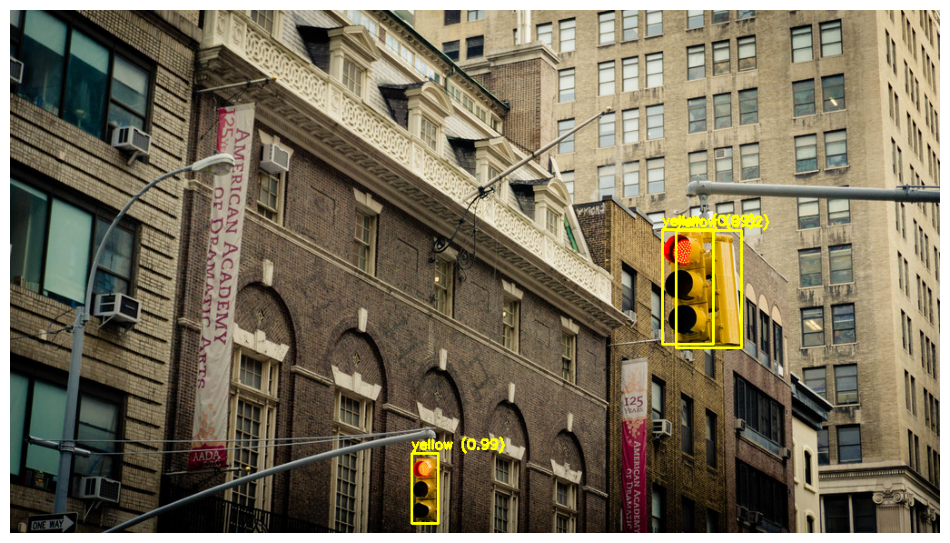

Semáforo #1: yellow (confiança: 0.99) na posição [442, 488, 29, 77]
Semáforo #2: yellow (confiança: 0.99) na posição [718, 242, 56, 126]
Semáforo #3: yellow (confiança: 0.82) na posição [733, 243, 72, 129]
../data/images/train/030b331b7d62d621.jpg


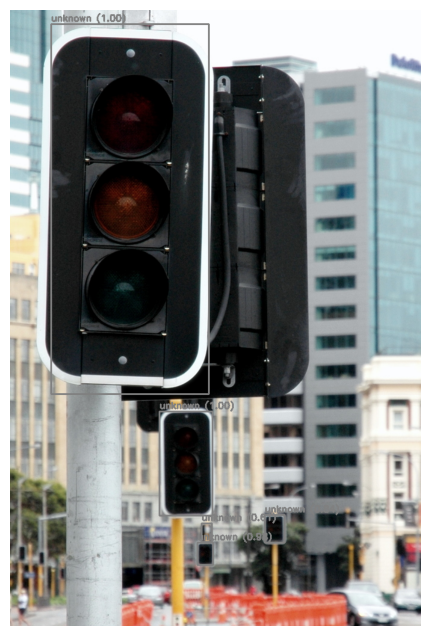

Semáforo #1: unknown (confiança: 1.00) na posição [68, 23, 262, 615]
Semáforo #2: unknown (confiança: 1.00) na posição [248, 667, 88, 173]
Semáforo #3: unknown (confiança: 0.98) na posição [311, 885, 26, 37]
Semáforo #4: unknown (confiança: 0.84) na posição [423, 839, 33, 46]
Semáforo #5: unknown (confiança: 0.61) na posição [318, 853, 17, 31]
../data/images/train/03c1f7f42d34695d.jpg


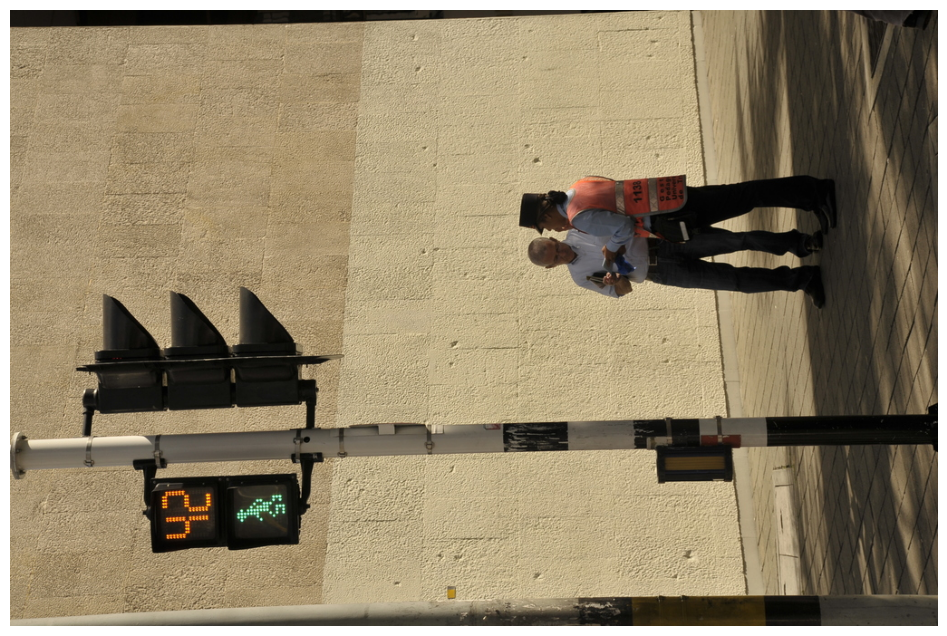

../data/images/train/048e120a93d0ab7c.jpg


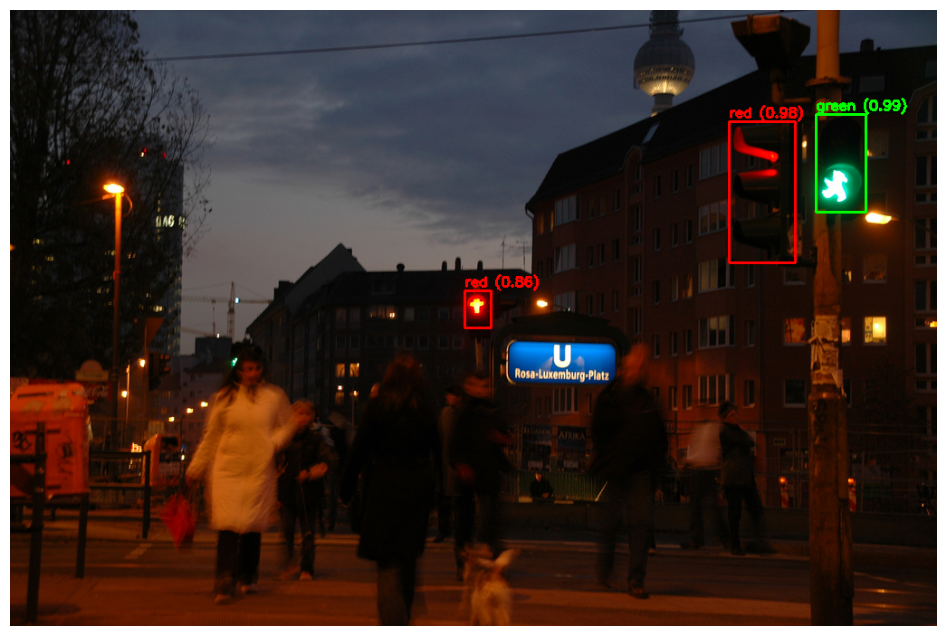

Semáforo #1: green (confiança: 0.99) na posição [890, 115, 55, 108]
Semáforo #2: red (confiança: 0.98) na posição [794, 123, 73, 156]
Semáforo #3: red (confiança: 0.86) na posição [502, 310, 29, 41]
../data/images/train/02cdd1db5dca298a.jpg


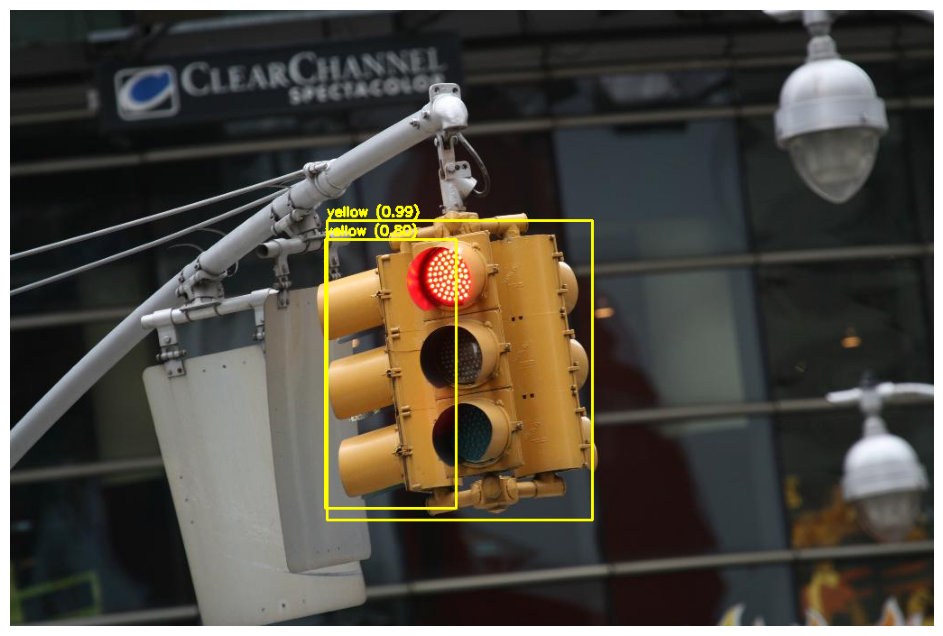

Semáforo #1: yellow (confiança: 0.99) na posição [351, 233, 294, 332]
Semáforo #2: yellow (confiança: 0.80) na posição [349, 254, 145, 298]
../data/images/train/03aff25c31c34fd2.jpg


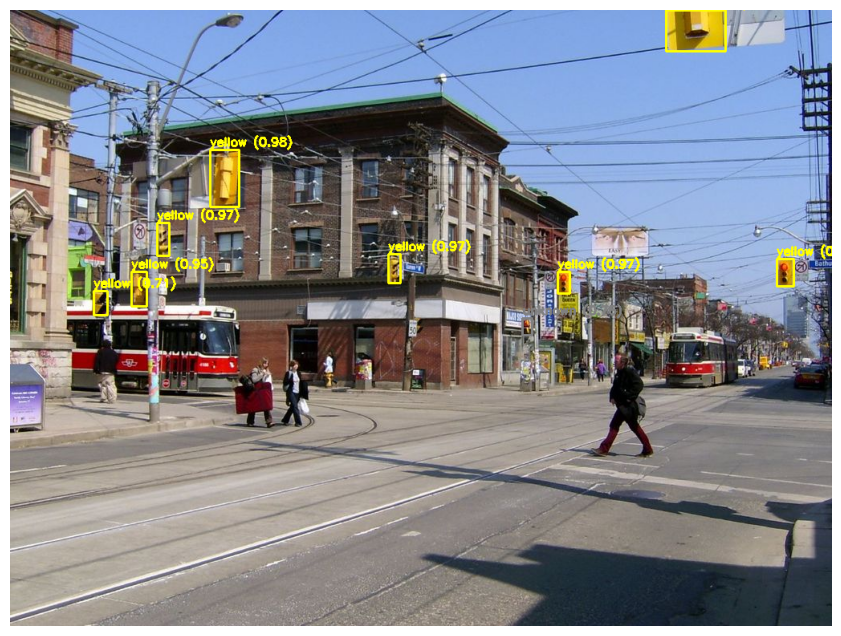

Semáforo #1: yellow (confiança: 0.98) na posição [249, 174, 36, 71]
Semáforo #2: yellow (confiança: 0.97) na posição [682, 326, 15, 27]
Semáforo #3: yellow (confiança: 0.97) na posição [471, 304, 15, 36]
Semáforo #4: yellow (confiança: 0.97) na posição [183, 265, 15, 41]
Semáforo #5: yellow (confiança: 0.96) na posição [955, 310, 21, 34]
Semáforo #6: yellow (confiança: 0.95) na posição [151, 326, 19, 43]
Semáforo #7: yellow (confiança: 0.87) na posição [817, 0, 74, 51]
Semáforo #8: unknown (confiança: 0.76) na posição [638, 384, 12, 21]
Semáforo #9: yellow (confiança: 0.71) na posição [104, 350, 17, 30]
../data/images/train/004320d39e78b5ef.jpg


KeyboardInterrupt: 

In [30]:
exclusions = ['01356be5630adca3.jpg']

# Exemplo de uso
pipeline = TrafficLightPipeline()

for image_path in os.listdir('../data/images/train/'):
    if image_path.endswith('.jpg') and image_path.split('/')[-1] not in exclusions:
        image_path = os.path.join('../data/images/train/', image_path)
        print(image_path)
        detections = pipeline.process_image(image_path)
        pipeline.visualize_results(image_path, detections)

        for i, detection in enumerate(detections):
            print(f"Semáforo #{i+1}: {detection.color} "
                  f"(confiança: {detection.confidence:.2f}) "
                  f"na posição {detection.box}")